## Import packages

In [1]:
import re
import sys
#!{sys.executable} -m pip install contractions
import contractions
from itertools import chain

#!{sys.executable} -m pip install inflect
import inflect
import string

import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
#nltk.download('stopwords')
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet as wn
from nltk.stem.wordnet import WordNetLemmatizer
from nltk import word_tokenize, pos_tag

from collections import defaultdict
tag_map = defaultdict(lambda : wn.NOUN)
tag_map['J'] = wn.ADJ
tag_map['V'] = wn.VERB
tag_map['R'] = wn.ADV

from pandas import DataFrame
import pandas as pd
import numpy as np


#!{sys.executable} -m pip install stanza
import stanza
#stanza.download('en')




## Training labels

In [2]:
trainingtweets = 'PA_training_tweets.txt'
traininglabels = 'PA_training_labels.txt'

#Traininglabels

trainlabels = []
with open(traininglabels, "r", encoding="latin-1") as rawdata:
    trainlabels.append(rawdata.read())

#Split into lines by new line
for item in trainlabels: 
    byline = item.split('\n')

    
#Make lines into lists
linelabels = []
for line in byline:
    splitlines = line.split(',')
    linelabels.append(splitlines)
    

## Training Tweets and Preprocessing

In [3]:
#TrainingTweets
data = []
with open(trainingtweets, "r", encoding="latin-1") as rawdata:
    data.append(rawdata.read())
    
#Split into lines by new line
for item in data: 
    byline = item.split('\n')

    
#Make lines into lists
linedata = []
for line in byline:
    splitlines = line.split(',',2)
    linedata.append(splitlines)
    
#Remove empty last item in the list
linedata = linedata[:-1]

#Clean
cleanedlinedata = []
for tweetid,timeofday,tweet in linedata:
    #NO URLS
    #noURL = re.sub(r"http\S+", "", tweet)
    
    #NO CONTRACTIONS
    noURL = re.sub(r"Ill", "I'll",  tweet)
    noCONTRACTIONS = contractions.fix(noURL)
    
    #NO ASCII
    encoded = noCONTRACTIONS.encode("ascii", "ignore")
    noASCII = encoded.decode()
   
    #NO Mentions with Parentheses
    #nomen = re.sub(r'\(@?\s.+\)', '', noASCII)
    
    #NO Mentions
    #nomen = re.sub(r'@\S+', '', noASCII)
    #nomen = re.sub(r'@\s\S+', '', nomen)
    
    #NO more new lines
    nonewlines = re.sub(r'\\n', '', noASCII)
    
    #NO capitalization
    nocaps = nonewlines.lower()
    
    #REMOVE quotationmarks
    noquote = nocaps.replace('"', '')
    
    #REMOVE duplicate punctuation
    remodup = re.sub(r'[.]+', '.', noquote)
    remodup = re.sub(r'[?]+', '?', remodup)
    remodup = re.sub(r'[!]+', '!', remodup)
    remodup = re.sub(r'[,]+', ',', remodup)
    remodup = re.sub(r'[_]+', '_', remodup)
    remodup = re.sub(r'\*', ' ', remodup)
    
    #numbers to words
    tokenizedsent = word_tokenize(remodup)
    wordified = []
    p = inflect.engine()
    for word in tokenizedsent:
        try:
            int(word)
            x = p.number_to_words(word)
            wordified.append(x)
        except ValueError:
            wordified.append(word)
    numtoword = ' '.join(wordified)

    
    #part of speech tag raw
    tokenizedsent = word_tokenize(numtoword)
    postokenizedsent = nltk.pos_tag(tokenizedsent)
    pos = []
    for word,tag in postokenizedsent:
        tag = str(word) + '_' + str(tag)
        pos.append(tag)
    postagged = ' '.join(pos)
    
    #lemmatizer
    lemma_function = WordNetLemmatizer()
    tokens = word_tokenize(numtoword)
    lemmaa = []
    for token, tag in pos_tag(tokens):
        lemma = lemma_function.lemmatize(token, tag_map[tag[0]])
        lemmaa.append(lemma)
    lemmaedsent = ' '.join(lemmaa)
    
    #part of speech tag lemma
    tokenizedsent = word_tokenize(lemmaedsent)
    postokenizedsent = nltk.pos_tag(tokenizedsent)
    pos = []
    for word,tag in postokenizedsent:
        tag = str(word) + '_' + str(tag)
        pos.append(tag)
    postaggedlemma = ' '.join(pos)
    
        
    
    final = [tweetid, timeofday, tweet, lemmaedsent, numtoword, postagged, postaggedlemma]
    cleanedlinedata.append(final)
    
#print(cleanedlinedata)   

## Feature extraction (Non-regex)
### Dependencies, sentiment, named entities

In [4]:
%%time

fordepextraction = []
for tweetid, timeofday, tweet, lemmaedsent, numtoword, postagged, postaggedlemma in cleanedlinedata:
    fordepextraction.append(numtoword)

    
#Sample
fordepsample = '\n\n'.join(fordepextraction[78:200])
noperiodsample = fordepsample.translate(str.maketrans('', '', string.punctuation))


##Join to make pipeline faster
fordep = '\n\n'.join(fordepextraction)
#Remove punctuations
noperiod = fordep.translate(str.maketrans('', '', string.punctuation))


#dependency info
nlp = stanza.Pipeline('en', tokenize_no_ssplit=True)
#doc = nlp(noperiodsample)
doc = nlp(noperiod)
#doc = nlp('\n\n God \n\n Manila ')


#SENTIMENTFOCUS
sentiment = []
for item in doc.sentences:
    it = item.sentiment
    sentiment.append(it)
    
#DEPENDENCY FOCUS
sentdep = []
for item in doc.sentences:
    it = item.to_dict()
    sentdep.append(it)


#SENTIMENT
sentimentt = []
for idx,sentencesent in enumerate(sentiment):
    if sentencesent == 0:
        sentimentt.append([idx+1000, '-1'])
    elif sentencesent == 1:
        sentimentt.append([idx+1000, '0'])
    elif sentencesent == 2:
        sentimentt.append([idx+1000, '1'])
    else:
        sentimentt.append('NA')


#Get MAIN SUBJECT 
subject = []
for idx,sentence in enumerate(sentdep):
    sentencesubj = []
    for dct in sentence:
        if len(sentencesubj) == 0:
            if dct['deprel'] == 'nsubj' or dct['deprel'] == 'subj':
                mv = dct['lemma'].lower()
                sentencesubj.append(idx+1000)
                sentencesubj.append(mv)
            else:
                pass
        else:
            pass
    
    if str(sentencesubj) == '[]':
        subject.append([idx+1000, 'NA'])
    else:
        subject.append(sentencesubj)

#Get MAIN SUBJECT ENTITY NAME TYPE
subjectner = []
for idx,sentence in enumerate(sentdep):
    sentencesubjentity = []
    for dct in sentence:
        if len(sentencesubjentity) == 0:
            if dct['deprel'] == 'nsubj' or dct['deprel'] == 'subj' :
                if dct['ner'] != 'O':
                    mv = dct['ner']
                    sentencesubjentity.append(idx+1000)
                    sentencesubjentity.append(mv)
                else:
                    pass
            else:
                pass
        else:
            pass
    if str(sentencesubjentity) == '[]':
        subjectner.append([idx+1000, 'NA'])
    else:
        subjectner.append(sentencesubjentity)
        

#Get ALL SUBJECTS 
allsubject = []
for idx,sentence in enumerate(sentdep):
    sentencesubj = []
    for dct in sentence:
        if dct['deprel'] == 'nsubj' or dct['deprel'] == 'subj' or dct['deprel'] == 'conj' :
            mv = dct['lemma'].lower()
            sentencesubj.append(mv)
        else:
            pass
    
    if str(sentencesubj) == '[]':
        allsubject.append([idx+1000, 'NA'])
    else:
        allsubject.append([idx+1000, sentencesubj])

#Get ALL SUBJECTS ENTITY TYPE 
allsubjectner = []
for idx,sentence in enumerate(sentdep):
    sentencesubjent = []
    for dct in sentence:
        if dct['deprel'] == 'nsubj' or dct['deprel'] == 'subj' or dct['deprel'] == 'conj' :
            if dct['ner'] != 'O':
                mv = dct['ner']
                sentencesubjent.append(mv)
            else:
                sentencesubjent.append('NA')
        else:
            pass
    
    if str(sentencesubjent) == '[]':
        allsubjectner.append([idx+1000, 'NA'])
    else:
        allsubjectner.append([idx+1000, sentencesubjent])
        

#Get OBJECT
obj = []
for idx,sentence in enumerate(sentdep):
    sentenceobj = []
    for dct in sentence:
        if len(sentenceobj) == 0:
            if dct['deprel'] == 'dobj' or dct['deprel'] == 'iobj' or dct['deprel'] == 'pobj' or dct['deprel'] == 'obj':
                mv = dct['lemma'].lower()
                sentenceobj.append(idx+1000)
                sentenceobj.append(mv)
            else:
                pass
        else:
            pass
    if str(sentenceobj) == '[]':
        obj.append([idx+1000, 'NA'])
    else:
        obj.append(sentenceobj)

#Get OBJECT ENTITY TYPE
objner = []
for idx,sentence in enumerate(sentdep):
    sentenceobjent = []
    for dct in sentence:
        if len(sentenceobjent) == 0:
            if dct['deprel'] == 'dobj' or dct['deprel'] == 'iobj' or dct['deprel'] == 'pobj' or dct['deprel'] == 'obj':
                if dct['ner'] != 'O':
                    mv = dct['ner']
                    sentenceobjent.append(idx+1000)
                    sentenceobjent.append(mv)            
                else:
                    pass
            else:
                pass
        else:
            pass
    
    if str(sentenceobjent) == '[]':
        objner.append([idx+1000, 'NA'])
    else:
        objner.append(sentenceobjent)

    
#Get NEGATION WORD
negw = []
for idx,sentence in enumerate(sentdep):
    sentencenegw = []
    for dct in sentence:
        if dct['deprel'] == 'advmod':
            if dct['text'] in ['never', 'not', 'no', 'nt']:
                sentencenegw.append([idx+1000, dct['text']])
            else:
                pass
        else:
            pass
        
    if str(sentencenegw) == '[]':
        negw.append([idx+1000, 'NA'])
    else:
        negw.append(sentencenegw[0])

    
        
    
    
#Get MAIN VERBS
mainverbs = []
for idx,sentence in enumerate(sentdep):
    sentencemainverb = []
    for dct in sentence:
        if dct['deprel'] == 'root':
            mv = dct['lemma'].lower()
            sentencemainverb.append(idx+1000)
            sentencemainverb.append(mv)
        else:
            pass
    mainverbs.append(sentencemainverb)

    
    
#GET MAIN VERB INFORMATION = TENSE
mainverbtense = []
for idx,sentence in enumerate(sentdep):

    for dct in sentence:
        if dct['deprel'] == 'root':
            try:
                mv = str(dct['feats'].lower())
                sentencemainverbinfo = mv.split('|')
                featuredic = {}
                for entry in sentencemainverbinfo:
                    x = entry.split('=')
                    featuredic[x[0]] = x[1]
            except KeyError:
                pass
        else:
            pass
    
    try:
        mainverbtense.append([idx+1000,featuredic['tense']])        
    except KeyError:
        mainverbtense.append([idx+1000, 'NA'])  

            
#GET MAIN VERB INFORMATION = MOOD
mainverbmood = []
for idx,sentence in enumerate(sentdep):

    for dct in sentence:
        if dct['deprel'] == 'root':
            try:
                mv = str(dct['feats'].lower())
                sentencemainverbinfo = mv.split('|')
                featuredic = {}
                for entry in sentencemainverbinfo:
                    x = entry.split('=')
                    featuredic[x[0]] = x[1]
            except KeyError:
                pass
        else:
            pass
    
    try:
        mainverbmood.append([idx+1000,featuredic['mood']] )  
    except KeyError:
        mainverbmood.append([idx+1000,'NA'] )  
        

#GET MAIN VERB INFORMATION = MOOD
mainverbform= []
for idx,sentence in enumerate(sentdep):

    for dct in sentence:
        if dct['deprel'] == 'root':
            try:
                mv = str(dct['feats'].lower())
                sentencemainverbinfo = mv.split('|')
                featuredic = {}
                for entry in sentencemainverbinfo:
                    x = entry.split('=')
                    featuredic[x[0]] = x[1]
            except KeyError:
                pass
        else:
            pass
    
    try:
        mainverbform.append([idx+1000,featuredic['verbform']] ) 
    except KeyError:
        mainverbform.append([idx+1000, 'NA']) 
        
#GET MAIN VERB INFORMATION = NUMBER
mainverbnum= []
for idx,sentence in enumerate(sentdep):

    for dct in sentence:
        if dct['deprel'] == 'root':
            try:
                mv = str(dct['feats'].lower())
                sentencemainverbinfo = mv.split('|')
                featuredic = {}
                for entry in sentencemainverbinfo:
                    x = entry.split('=')
                    featuredic[x[0]] = x[1]
            except KeyError:
                pass
        else:
            pass
    
    try:
        mainverbnum.append([idx+1000,featuredic['number']] ) 
    except KeyError:
        mainverbnum.append([idx+1000,'NA']) 
   
        
        
#Get ALL VERBS
verbs = []
for idx,sentence in enumerate(sentdep):
    sentenceverb = []
    for dct in sentence:
        if dct['upos'] == 'VERB':
            xs = dct['lemma'].lower()
            sentenceverb.append(xs) 
        else:
            pass
    if str(sentenceverb) == '[]':
        verbs.append([idx+1000, 'NA'])
    else:
        verbs.append([idx+1000, [', '.join(sentenceverb)]])
        
    

#Get ALL ENTITY NAMES 
allentitynames = []
for idx,sentence in enumerate(sentdep):
    sentenceent = []
    for dct in sentence:
        if dct['ner'] != 'O':
            sentenceent.append(dct['text'])
        else:
            pass
    
    if str(sentenceent) == '[]':
        allentitynames.append([idx+1000, 'NA'])
    else:
        allentitynames.append([idx+1000,sentenceent])

#Get ALL ENTITY NAMES 
allentityner = []
for idx,sentence in enumerate(sentdep):
    sentenceent = []
    for dct in sentence:
        if dct['ner'] != 'O':
            sentenceent.append(dct['ner'])
        else:
            pass
    
    if str(sentenceent) == '[]':
        allentityner.append([idx+1000, 'NA'])
    else:
        allentityner.append([idx+1000,sentenceent])


2021-03-22 13:25:57 INFO: Loading these models for language: en (English):
| Processor | Package   |
-------------------------
| tokenize  | combined  |
| pos       | combined  |
| lemma     | combined  |
| depparse  | combined  |
| sentiment | sstplus   |
| ner       | ontonotes |

2021-03-22 13:25:57 INFO: Use device: cpu
2021-03-22 13:25:57 INFO: Loading: tokenize
2021-03-22 13:25:57 INFO: Loading: pos
2021-03-22 13:25:58 INFO: Loading: lemma
2021-03-22 13:25:58 INFO: Loading: depparse
2021-03-22 13:25:59 INFO: Loading: sentiment
2021-03-22 13:26:00 INFO: Loading: ner
2021-03-22 13:26:01 INFO: Done loading processors!


CPU times: user 6min 36s, sys: 1min 5s, total: 7min 42s
Wall time: 7min 54s


## Printing (and storing)

In [5]:
forstoring = [sentimentt, subject, subjectner, allsubject, allsubjectner, negw, mainverbs, mainverbtense, mainverbmood, mainverbnum, mainverbform, obj, objner, verbs, allentitynames, allentityner]
%store doc
for item in forstoring:
    print(item)
    %store item


#TO CHECK IF LENGTH THE SAME
#for idx,item in enumerate(forstoring):
#    for token in item:
#        if len(token) != 2:
#            print(idx)
#            print(token)
#        else:
#            pass

#obj[2805]
#objner[2805]


Stored 'doc' (Document)
[[1000, '0'], [1001, '0'], [1002, '1'], [1003, '1'], [1004, '-1'], [1005, '0'], [1006, '0'], [1007, '0'], [1008, '-1'], [1009, '1'], [1010, '0'], [1011, '0'], [1012, '0'], [1013, '0'], [1014, '0'], [1015, '1'], [1016, '0'], [1017, '-1'], [1018, '0'], [1019, '0'], [1020, '1'], [1021, '0'], [1022, '0'], [1023, '0'], [1024, '0'], [1025, '1'], [1026, '0'], [1027, '0'], [1028, '-1'], [1029, '0'], [1030, '0'], [1031, '0'], [1032, '-1'], [1033, '1'], [1034, '0'], [1035, '0'], [1036, '1'], [1037, '0'], [1038, '0'], [1039, '0'], [1040, '-1'], [1041, '1'], [1042, '-1'], [1043, '1'], [1044, '-1'], [1045, '-1'], [1046, '1'], [1047, '-1'], [1048, '0'], [1049, '0'], [1050, '0'], [1051, '0'], [1052, '0'], [1053, '0'], [1054, '-1'], [1055, '0'], [1056, '0'], [1057, '0'], [1058, '1'], [1059, '-1'], [1060, '1'], [1061, '-1'], [1062, '-1'], [1063, '0'], [1064, '0'], [1065, '0'], [1066, '-1'], [1067, '-1'], [1068, '0'], [1069, '1'], [1070, '0'], [1071, '-1'], [1072, '0'], [1073, '-

## Dataframe

In [6]:
noheaderdata = cleanedlinedata[1:]
datmas = DataFrame(noheaderdata,columns=['tweetid','timeofday','tweetorig','tweetlemma','tweetcleaned','tweetpos','tweetposlemma'])

noheaderlabel = (linelabels[1:])[:-1]
datlabels = DataFrame(noheaderlabel, columns = ['tweetid', 'activity'])

datmaster = pd.merge(datmas, datlabels, on="tweetid")

dmaster = datmaster[:-1]

dmaster.head()


,tweetid,timeofday,tweetorig,tweetlemma,tweetcleaned,tweetpos,tweetposlemma,activity
0,1001,17,The Bulldogs have been selected to finish 4th ...,the bulldog have be select to finish 4th in th...,the bulldogs have been selected to finish 4th ...,the_DT bulldogs_NNS have_VBP been_VBN selected...,the_DT bulldog_NN have_VBP be_VB select_VBN to...,0
1,1002,22,Played disc golf. Got a tattoo. Heading to Det...,play disc golf . get a tattoo . head to detroi...,played disc golf . got a tattoo . heading to d...,played_VBN disc_NN golf_NN ._. got_VBD a_DT ta...,play_NN disc_NN golf_NN ._. get_VB a_DT tattoo...,1
2,1003,16,Sunday big football game I'm gunna gather all ...,sunday big football game i be gunna gather all...,sunday big football game i am gunna gather all...,sunday_NN big_JJ football_NN game_NN i_NN am_V...,sunday_NN big_JJ football_NN game_NN i_NN be_V...,0
3,1004,20,Despite my resolution to be nicer to Scooter t...,despite my resolution to be nicer to scooter t...,despite my resolution to be nicer to scooter t...,despite_IN my_PRP$ resolution_NN to_TO be_VB n...,despite_IN my_PRP$ resolution_NN to_TO be_VB n...,0
4,1005,18,"""Reassigned by Michigan Runner to shoot Goodli...",reassign by michigan runner to shoot goodlife ...,reassigned by michigan runner to shoot goodlif...,reassigned_VBN by_IN michigan_JJ runner_NN to_...,reassign_NN by_IN michigan_JJ runner_NN to_TO ...,0


In [7]:
forstoring2 = ['sentimentt', 'subject', 'subjectner', 'allsubject', 'allsubjectner', 'negw', 'mainverbs', 'mainverbtense', 'mainverbmood', 'mainverbnum', 'mainverbform', 'obj', 'objner', 'verbs', 'allentitynames', 'allentityner']
forstoring = [sentimentt, subject, subjectner, allsubject, allsubjectner, negw, mainverbs, mainverbtense, mainverbmood, mainverbnum, mainverbform, obj, objner, verbs, allentitynames, allentityner]
dicname = {}
for idx, item in enumerate(forstoring2):
    dicname[idx] = item
for idx, item in enumerate(forstoring):
    x = (item[1:])[:-1]
    datlabels = DataFrame(x, columns = ['tweetid', dicname[idx]])
    datlabels['tweetid'] = datlabels['tweetid'].astype(int)
    dmaster['tweetid'] = dmaster['tweetid'].astype(int)
    dmaster = pd.merge(dmaster, datlabels, on = 'tweetid' )



<ipython-input-7-926b0cb4d454>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dmaster['tweetid'] = dmaster['tweetid'].astype(int)


In [8]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_columns', None)  
pd.set_option('display.max_rows', None)  
dmaster[20:40]

,tweetid,timeofday,tweetorig,tweetlemma,tweetcleaned,tweetpos,tweetposlemma,activity,sentimentt,subject,subjectner,allsubject,allsubjectner,negw,mainverbs,mainverbtense,mainverbmood,mainverbnum,mainverbform,obj,objner,verbs,allentitynames,allentityner
20,1021,1,I be walking past my old EX's and friends like I never knew them.,i be walk past my old ex 's and friends like i never know them .,i be walking past my old ex 's and friends like i never knew them .,i_NN be_VB walking_VBG past_IN my_PRP$ old_JJ ex_NN 's_POS and_CC friends_VBZ like_IN i_NN never_RB knew_VBD them_PRP ._.,i_RB be_VB walk_NN past_IN my_PRP$ old_JJ ex_NN 's_POS and_CC friends_VBZ like_IN i_NN never_RB know_VBP them_PRP ._.,0,0,i,NA,"[i, friend, i]","[NA, NA, NA]",never,walk,pres,NA,NA,part,they,NA,"[walk, know]",NA,NA
21,1022,21,"""I'm at Elite personal fitness (10358 Gratiot, Richmond) http://t.co/pbJQOCMR""","i be at elite personal fitness ( ten thousand , three hundred and fifty-eight gratiot , richmond ) http : //t.co/pbjqocmr","i am at elite personal fitness ( ten thousand, three hundred and fifty-eight gratiot , richmond ) http : //t.co/pbjqocmr","i_NN am_VBP at_IN elite_JJ personal_JJ fitness_NN (_( ten_JJ thousand_CD ,_, three_CD hundred_VBD and_CC fifty-eight_JJ gratiot_NN ,_, richmond_NN )_) http_NN :_: //t.co/pbjqocmr_NN","i_NN be_VB at_IN elite_JJ personal_JJ fitness_NN (_( ten_JJ thousand_CD ,_, three_CD hundred_VBD and_CC fifty-eight_JJ gratiot_NN ,_, richmond_NN )_) http_NN :_: //t.co/pbjqocmr_NN",1,0,i,NA,"[i, tcopbjqocmr]","[NA, NA]",NA,fitness,NA,NA,sing,NA,NA,NA,NA,NA,NA
22,1023,19,"""Baked Potato the #vegan way ~ black bean corn salsa, red onion, arugula, and sirachi #vegetarianäÛ_ https://t.co/OJ4fg9nPaB""","bake potato the # vegan way ~ black bean corn salsa , red onion , arugula , and sirachi # vegetarian_ http : //t.co/oj4fg9npab","baked potato the # vegan way ~ black bean corn salsa , red onion , arugula , and sirachi # vegetarian_ https : //t.co/oj4fg9npab","baked_VBN potato_IN the_DT #_# vegan_JJ way_NN ~_NNP black_JJ bean_NN corn_NN salsa_NN ,_, red_JJ onion_NN ,_, arugula_NN ,_, and_CC sirachi_RB #_# vegetarian__JJ https_NN :_: //t.co/oj4fg9npab_NN","bake_NN potato_VBZ the_DT #_# vegan_JJ way_NN ~_NNP black_JJ bean_NN corn_NN salsa_NN ,_, red_JJ onion_NN ,_, arugula_NN ,_, and_CC sirachi_RB #_# vegetarian__JJ http_NN :_: //t.co/oj4fg9npab_NN",0,0,NA,NA,[http],[NA],NA,potato,NA,NA,sing,NA,NA,NA,[bake],NA,NA
23,1024,1,"""in case you missed the first few innings tonight, checked swing strikeouts are where it's at. #sanchez""","in case you miss the first few inning tonight , check swing strikeout be where it be at . # sanchez","in case you missed the first few innings tonight , checked swing strikeouts are where it is at . # sanchez","in_IN case_NN you_PRP missed_VBD the_DT first_JJ few_JJ innings_NNS tonight_NN ,_, checked_VBD swing_NN strikeouts_NNS are_VBP where_WRB it_PRP is_VBZ at_IN ._. #_# sanchez_NN","in_IN case_NN you_PRP miss_VBP the_DT first_JJ few_JJ inning_NN tonight_NN ,_, check_VB swing_VBG strikeout_RB be_VB where_WRB it_PRP be_VB at_IN ._. #_# sanchez_NN",0,0,you,NA,"[you, it]","[NA, NA]",NA,miss,past,ind,NA,fin,inning,NA,"[miss, check]","[first, tonight]","[S-ORDINAL, S-TIME]"
24,1025,1,S/O to @_BornWithTalent for the fresh cooked White Castle #RealMVP,s/of to @ _bornwithtalent for the fresh cooked white castle # realmvp,s/of to @ _bornwithtalent for the fresh cooked white castle # realmvp,s/of_NN to_TO @_VB _bornwithtalent_NN for_IN the_DT fresh_JJ cooked_JJ white_JJ castle_NN #_# realmvp_NN,s/of_NN to_TO @_VB _bornwithtalent_NN for_IN the_DT fresh_JJ cooked_JJ white_JJ castle_NN #_# realmvp_NN,0,1,NA,NA,NA,NA,NA,sof,NA,NA,sing,NA,NA,NA,[cook],NA,NA
25,1026,0,Ere body run yo,ere body run yo,ere body run yo,ere_RB body_NN run_VB yo_RB,ere_RB body_NN run_VB yo_RB,0,0,body,NA,[body],[NA],NA,run,NA,imp,NA,fin,NA,NA,[run],NA,NA
26,1027,19,$10 he walks the bases loaded. #BackBenoit,$ ten he walk the base load . # backben

## Feature Extraction

In [9]:
datfeat = dmaster

### Feature - length of tweet
datfeat['lentweet'] = datfeat['tweetcleaned'].str.count(' ') + 1

### Feature - Hyponyms of sport - lexsport
from nltk.corpus import wordnet as wn
sport = wn.synset('sport.n.01')
typesOfsport = list(set([w for s in sport.closure(lambda s:s.hyponyms()) for w in s.lemma_names()]))

sporttype = []
lemma_function = WordNetLemmatizer()
for token, tag in pos_tag(typesOfsport):
    x = token.replace("_", " ").replace("-", " ")
    lemma = lemma_function.lemmatize(x, tag_map[tag[0]])
    y = lemma.split(' ')
    z = token.replace("_", " ").replace("-", " ").split(' ')
    for item in y:
        lem = lemma_function.lemmatize(item, tag_map[tag[0]])
        sporttype.append(lem)   
    for item in z:
        sporttype.append(item)

lexsport = []
for token, tag in pos_tag(sporttype):
    if tag == 'CD' or tag == 'DT':
        pass
    else:
        lexsport.append(token)
lexsport = list(set(lexsport))
pattern = '|'.join(lexsport)
import numpy as np

datfeat['verbsstr'] = datfeat.verbs.apply(str)

datfeat['lexsport'] = np.where(((datfeat.tweetlemma.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexsportverb'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexsportmv'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexsportobj'] = np.where(((datfeat.obj.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)


### Feature - Passive

synonyms = []
#morepass = 'To increase  broaden     enlarge     exceed     expand  generate     improve     maximize     optimize  To decrease  decline     deteriorate     erode     minimize  narrow     reduce     worsen  Difference or variance     alter     contrast     convert     deviate   differ     differentiate     distinguish     diverge  evolve     modify     revise     transform  Stability  maintain     sustain  Keeping within a certain range/ under a certain level   confine     inhibit     prohibit     restrict  In-depth study  analyze     examine    investigate     observe survey  Stating Ideas/Concepts     acknowledge      argue     attribute     comment        propose  establish     identify     mention     note     observe      state  Restating Ideas/Concepts  elaborate    expand  Emphasizing Ideas/Concepts  emphasize      stress  Describe phenomena  acquire     define     impact      signify       symbolize  Describe data  approximate      demonstrate        indicate  levels off      reflect  Stating positive position  advocate         hypothesize       propose  Stating negative position/to contradict  deny      dispute    negate     reject      Uncertainty  predict      speculate  Extrapolation of information  deduce     imply     infer     project  Show components  comprise     consist      constitute       incorporate'
#tok = word_tokenize(morepass)
 
words = ['improve', 'maximize', 'watch', 'sit', 'know', 'compute', 'say', 'argue', 'think', 'lay', 'rest', 'put', 'receive', 'put on', 'taste', 'touch', 'see', 'smell', 'hear', 'listen']

#words = tok+words

for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)
            
syn = (set(synonyms))
pattern = '|'.join(syn)
datfeat['verbsstr'] = datfeat.verbs.apply(str)


datfeat['mvpassive'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['vbpassive'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)

### NEW Feature - Feeling or Thinking or Emotion
synonyms = []
words = ['think', 'feel', 'believe', 'opine', 'consider']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))

pattern = '|'.join(syn)
datfeat['verbsstr'] = datfeat.verbs.apply(str)
datfeat['mvfeelthinkemo'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['vbfeelthinkemo'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)

### NEW Feature - Feeling
synonyms = []
words = ['feel']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))

pattern = '|'.join(syn)
datfeat['verbsstr'] = datfeat.verbs.apply(str)
datfeat['mvfeel'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['vbfeel'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)

### NEW Feature - Thinking
synonyms = []
words = ['think']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))

pattern = '|'.join(syn)
datfeat['verbsstr'] = datfeat.verbs.apply(str)
datfeat['mvthink'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['vbthink'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)

### NEW Feature - Believe
synonyms = []
words = ['believe']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))

pattern = '|'.join(syn)
datfeat['verbsstr'] = datfeat.verbs.apply(str)
datfeat['mvbelieve'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['vbbelieve'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)

### NEW Feature - tired
synonyms = []
words = ['tired', 'exhausted', 'exhaustion', 'fatigue', 'sweat']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).replace("-", "").split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))
print(syn)
pattern = '|'.join(syn)
datfeat['verbsstr'] = datfeat.verbs.apply(str)
datfeat['mvtired'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['vbtired'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['tweettired'] = np.where(((datfeat.tweetlemma.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)





### NEW Feature - Hyponyms of feelings - lexemotions
from nltk.corpus import wordnet as wn
emotion = wn.synset('emotion.n.01')
typesOfemotion = list(set([w for s in emotion.closure(lambda s:s.hyponyms()) for w in s.lemma_names()]))


emotiontype = []
lemma_function = WordNetLemmatizer()
for token, tag in pos_tag(typesOfemotion):
    x = token.replace("_", " ").replace("-", " ")
    lemma = lemma_function.lemmatize(x, tag_map[tag[0]])
    y = lemma.split(' ')
    z = token.replace("_", " ").replace("-", " ").split(' ')
    for item in y:
        lem = lemma_function.lemmatize(item, tag_map[tag[0]])
        emotiontype.append(lem)   
    for item in z:
        emotiontype.append(item)

lexemotion = []
for token, tag in pos_tag(emotiontype):
    if tag == 'VBZ' or tag == 'VBD' or tag == 'VBP' or tag == 'VBG' or tag == 'VBN':
        lexemotion.append(token)
    else:
        pass

lexemotion = set(lexemotion)
pattern = '|'.join(lexemotion)


lexemotionnoun = []
for token, tag in pos_tag(emotiontype):
    if tag == 'NN':
        lexemotionnoun.append(token)
    else:
        pass

lexemotionnoun = set(lexemotionnoun)
pattern2 = '|'.join(lexemotionnoun)
    
datfeat['lexemotion'] = np.where(((datfeat.tweetlemma.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexemotionverb'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexemotionmv'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexemotionobj'] = np.where(((datfeat.obj.str.contains(pattern2)) & (datfeat['negw'] == 'NA')), 1, 0)




### Feature - Hyponyms of activity - lexactivity
from nltk.corpus import wordnet as wn
activity = wn.synset('activity.n.01')
typesOfactivity = list(set([w for s in activity.closure(lambda s:s.hyponyms()) for w in s.lemma_names()]))

acttype = []
lemma_function = WordNetLemmatizer()
for token, tag in pos_tag(typesOfactivity):
    x = token.replace("_", " ").replace("-", " ")
    lemma = lemma_function.lemmatize(x, tag_map[tag[0]])
    y = lemma.split(' ')
    z = token.replace("_", " ").replace("-", " ").split(' ')
    for item in y:
        lem = lemma_function.lemmatize(item, tag_map[tag[0]])
        acttype.append(lem)   
    for item in z:
        acttype.append(item)

lexact = []
for token, tag in pos_tag(acttype):
    if tag == 'VBZ' or tag == 'VBD' or tag == 'VBP' or tag == 'VBG' or tag == 'VBN':
        lexact.append(token)
    else:
        pass

lexact = set(lexact)
pattern = '|'.join(lexact)


lexactnoun = []
for token, tag in pos_tag(acttype):
    if tag == 'NN':
        lexactnoun.append(token)
    else:
        pass

lexactnoun = set(lexactnoun)
pattern2 = '|'.join(lexactnoun)
    
datfeat['lexact'] = np.where(((datfeat.tweetlemma.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexactverb'] = np.where(((datfeat.verbsstr.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexactmv'] = np.where(((datfeat.mainverbs.str.contains(pattern)) & (datfeat['negw'] == 'NA')), 1, 0)
datfeat['lexactobj'] = np.where(((datfeat.obj.str.contains(pattern2)) & (datfeat['negw'] == 'NA')), 1, 0)

### PERSONAL PRONOUN I
regex = r'i'
datfeat['perspronoun'] = np.where(datfeat.subject.str.contains(regex), 1, 0)

### PAST
regex = r'past'
datfeat['mvpast'] = np.where(datfeat.mainverbtense.str.contains(regex), 1, 0)

### PRESENT
regex = r'pres'
datfeat['mvpres'] = np.where(datfeat.mainverbtense.str.contains(regex), 1, 0)

##PERSON
regex = r'PERSON'
datfeat['typ'] = datfeat.allentityner.apply(str)
datfeat['person'] = np.where(datfeat.typ.str.contains(regex), 1, 0)


##NEGATION
regex = r'NA'
datfeat['negation'] = datfeat.negw.apply(str)
datfeat['negation'] = np.where(datfeat.negation.str.contains(regex), 0, 1)


##SUBJECT
datfeat['hassubject'] = datfeat.subject.apply(str)
datfeat['hassubject'] = np.where(datfeat.hassubject.str.contains('NA'), 0, 1)

##OBJECT
datfeat['hasobject'] = datfeat.obj.apply(str)
datfeat['hasobject'] = np.where(datfeat.hasobject.str.contains('NA'), 0, 1)

##VERB
datfeat['hasverb'] = datfeat.verbsstr.apply(str)
datfeat['hasverb'] = np.where(datfeat.hasverb.str.contains('NA'), 0, 1)

                              
                              
### REGEX REGULAR
#regex = r' a '
#datfeat['three'] = np.where(datfeat.tweetcleaned.str.contains(regex), 1, 0)



{'jade', 'tired', 'use', 'commonplace', 'expel', 'upon', 'banal', 'exertion', 'exhaustion', 'hackneyed', 'fag', 'worn', 'timeworn', 'run', 'perspiration', 'fatigue', 'grease', 'sap', 'consume', 'out', 'wear', 'played', 'exhausted', 'fagged', 'eat', 'tiredness', 'eject', 'tucker', 'threadbare', 'down', 'fret', 'wellworn', 'effort', 'elbow', 'debilitation', 'enervation', 'travail', 'wipe', 'deplete', 'oldhat', 'spent', 'up', 'through', 'wornout', 'duty', 'swither', 'washedout', 'play', 'lather', 'perspire', 'wash', 'sweat', 'tire', 'stock', 'release', 'fatigued', 'beat', 'weary', 'weariness', 'exhaust', 'outwear', 'shopworn', 'trite', 'bore', 'stew', 'enfeeblement', 'discharge', 'dogtired', 'pall', 'sudor', 'sudate'}


## Tfidf

In [10]:
from sklearn.feature_extraction.text import CountVectorizer
from nltk.stem.porter import PorterStemmer

porter_stemmer = PorterStemmer()


def stemming_tokenizer(str_input):
    words = re.sub(r"[^A-Za-z]", " ", str_input).lower().split()
    pattern = re.compile(r'\b(' + r'|'.join(stopwords.words('english')) + r')\b\s*')
    text = [pattern.sub('', word) for word in words]
    words = [porter_stemmer.stem(word) for word in text]
    return words

count_vectorizer = CountVectorizer(tokenizer=stemming_tokenizer)

# .fit_transfer TOKENIZES and COUNTS
X = count_vectorizer.fit_transform(datfeat['tweetlemma'])
countvec = count_vectorizer.fit_transform(datfeat['tweetlemma'])
countfreq = pd.DataFrame(X.toarray(), columns=count_vectorizer.get_feature_names())
countfreq.head()

,,aaa,aajoa,aalaoui,aatc,ab,abandon,abbbieg,abbi,abd,abe,abhorr,abibi,abil,abj,abl,abomin,abort,abortmeplz,abraham,absolut,abt,abus,ac,academi,acapc,acblsx,accept,access,accessori,accid,accident,accommod,accomplish,account,accuraci,ace,acepz,acha,achiev,achildofgod,achockey,acknowledg,ackr,acof,acoupeofdaysago,acr,acresto,acro,acrobat,across,act,action,activ,activerestday,activist,actor,actual,ad,adam,adamjahn,add,addi,addict,ade,adhdatz,adher,adhqewvi,adicchun,adida,adidasskateboard,adidasu,adio,adlytagi,adnw,adoba,adobadearborn,adobo,adopt,ador,adra,adrian,adrienn,adriennelesper,adriennesbro,adult,advanc,advantag,adventur,advertis,advic,advok,aef,aeg,aelga,aepz,aeqkn,aerial,aerin,aerob,aerosmith,aesthet,aewxnxldu,af,afff,afg,afkxwhyc,afraid,african,afterlif,afternoon,afxambmb,age,agenda,agent,aggress,agh,agianst,agilehostil,agiqwxfmqj,agit,aglaaaz,agmzhxqii,ago,agof,agre,aground,ah,ahccmjg,ahead,aheejewel,ahgir,ahh,ahoo,ahozrsyu,ahust,ahxsyqz,ai,aiachat,aiayaf,aid,aidan,aigmzhvi,aimeem,aimlessli,air,airborn,airmax,airport,airtim,airtimetroy,aisl,ajkazyak,ajwibmh,ak,aka,akinyel,akqkndyboc,akycen,al,alabama,alarm,alb,album,alcohol,aldrich,ale,alert,aleu,alex,alexafoot,alexandgabbi,alexandria,alexbirrr,alexilala,alexthecargirl,algcsz,alhamdullilah,alien,alimshield,alittl,aliv,alk,allan,allblackeveryth,allegi,allegrofit,allen,alley,allhim,alli,allisonbiskup,alll,allll,allot,allow,allstar,allstarsoftbal,alltrack,allyjosephin,almightybm,almost,almrlm,aloha,alon,alondam,along,alot,alpha,alra,alrea,alreadi,alright,also,altern,alternat,although,alum,alumnu,alway,alwaysthetop,alysevictor,alyssa,alyssah,amalia,amanda,amaz,amazin,amberrlynch,ambianc,ambient,ambit,ambnichol,amd,america,american,americanoutlaw,americasgottal,amez,ami,amiwinningorlos,amo,amon,among,amp,amphibi,amrep,amtrainingrid,amus,amyandrewsfox,anatomi,anc,ancelloti,anchor,anddddd,andecarlomusto,andi,andiamoitalia,andmi,andov,andrea,andrew,andrewricegolf,android,androidgam,angel,angela,angelheadhipstr,angelicaleigh,angelswhisp,angiedavi,angl,angri,ankl,ann,annarbor,anni,anniversari,announc,annoy,annual,annzu,anoth,anr,answer,ant,antczak,anthem,anthonygattin,anthraxjon,anticip,antiextens,antionett,antiqu,anxboc,anxiou,anybodi,anyday,anymor,anyon,anyth,anytim,anytimefit,anyway,anywher,aoca,aoki,ap,apart,apc,apoevtc,apolog,app,appar,apparel,appear,appl,applaus,applemus,appli,applic,appoint,appreci,appropri,approv,appt,apqxkc,april,apt,apxtiydkvx,apzp,aq,aqgdc,aqirulz,aqpa,aqua,aquariu,aquat,ar,ara,araephotographi,araz,arbor,arborday,arboretum,arcad,archeri,archiv,archwitch,arcticfx,arcticfxgraph,area,arena,areyoutweet,argu,ari,aria,arikfritz,arlington,arm,armada,armbj,armour,arnold,around,array,arrest,arresteddevelop,arriv,arsen,art,artesa,artesaavdullaj,articl,artistri,artwork,arugula,arv,arw,arx,arxindd,asburi,asdcsg,asf,ash,asham,ashley,ashleynicmar,ashleyrpark,ashleyswestland,ashleyzarra,ashmaurya,ashtangaprimari,asiaalexand,asian,asid,ask,asl,asleep,aspep,ass,assault,assembl,asshol,assist,asst,assum,astrogam,astrolog,astronautnatesk,asu,atcvk,ate,athdbbsger,athen,athensh,athlet,athleta,athlon,atkdigvki,atlanta,atlanti,atleast,atletico,atmospher,attack,attard,attempt,attend,attent,attitud,attn,attorney,attract,atwaterb,atyyogq,au,aubcragg,aubriecard,auburn,auburnhil,audac,audcel,audit,audreyriddl,aug,august,augusta,aunt,auntietim,austin,australian,australiashona,author,auto,autobik,automat,autumnnight,av,avail,avdcjddt,ave,averag,avferna,avila,avlb,avocado,avto,aw,await,awak,awar,award,away,awbz,awd,awe,awesom,awew,awhil,awj,awk,awkward,awkwardli,awoln,aww,awwwwsom,awwwww,ax,axe,axlebrew,axrrgvkj,axsxaosjcc,axv,ay,ayac,ayatollah,aye,ayi,az,azariajaeden,azhauxqli,azoltowski,azukcko,b,ba,baaaaaaaaaaaaaaaaaaaaaacc,bab,babaaayyyi,babe,babi,babyc,babygirl,babysit,babyyruth,bac,bachata,bachelor,bachelorett,bachelorlif,back,backatitagain,backbeat,backbenoit,backc,backchannel,backday,backer,backpack,backstag,backstrok,backtotheoldm,backyard,bacon,bad,badassasuka,baddest,badg,

In [11]:
##TFIDF
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer(tokenizer=stemming_tokenizer, use_idf=True, norm='l2')

X = tfidf_vectorizer.fit_transform(datfeat['tweetlemma'])
dattfidf = pd.DataFrame(X.toarray(), columns=tfidf_vectorizer.get_feature_names())
dattfidf.head()

,,aaa,aajoa,aalaoui,aatc,ab,abandon,abbbieg,abbi,abd,abe,abhorr,abibi,abil,abj,abl,abomin,abort,abortmeplz,abraham,absolut,abt,abus,ac,academi,acapc,acblsx,accept,access,accessori,accid,accident,accommod,accomplish,account,accuraci,ace,acepz,acha,achiev,achildofgod,achockey,acknowledg,ackr,acof,acoupeofdaysago,acr,acresto,acro,acrobat,across,act,action,activ,activerestday,activist,actor,actual,ad,adam,adamjahn,add,addi,addict,ade,adhdatz,adher,adhqewvi,adicchun,adida,adidasskateboard,adidasu,adio,adlytagi,adnw,adoba,adobadearborn,adobo,adopt,ador,adra,adrian,adrienn,adriennelesper,adriennesbro,adult,advanc,advantag,adventur,advertis,advic,advok,aef,aeg,aelga,aepz,aeqkn,aerial,aerin,aerob,aerosmith,aesthet,aewxnxldu,af,afff,afg,afkxwhyc,afraid,african,afterlif,afternoon,afxambmb,age,agenda,agent,aggress,agh,agianst,agilehostil,agiqwxfmqj,agit,aglaaaz,agmzhxqii,ago,agof,agre,aground,ah,ahccmjg,ahead,aheejewel,ahgir,ahh,ahoo,ahozrsyu,ahust,ahxsyqz,ai,aiachat,aiayaf,aid,aidan,aigmzhvi,aimeem,aimlessli,air,airborn,airmax,airport,airtim,airtimetroy,aisl,ajkazyak,ajwibmh,ak,aka,akinyel,akqkndyboc,akycen,al,alabama,alarm,alb,album,alcohol,aldrich,ale,alert,aleu,alex,alexafoot,alexandgabbi,alexandria,alexbirrr,alexilala,alexthecargirl,algcsz,alhamdullilah,alien,alimshield,alittl,aliv,alk,allan,allblackeveryth,allegi,allegrofit,allen,alley,allhim,alli,allisonbiskup,alll,allll,allot,allow,allstar,allstarsoftbal,alltrack,allyjosephin,almightybm,almost,almrlm,aloha,alon,alondam,along,alot,alpha,alra,alrea,alreadi,alright,also,altern,alternat,although,alum,alumnu,alway,alwaysthetop,alysevictor,alyssa,alyssah,amalia,amanda,amaz,amazin,amberrlynch,ambianc,ambient,ambit,ambnichol,amd,america,american,americanoutlaw,americasgottal,amez,ami,amiwinningorlos,amo,amon,among,amp,amphibi,amrep,amtrainingrid,amus,amyandrewsfox,anatomi,anc,ancelloti,anchor,anddddd,andecarlomusto,andi,andiamoitalia,andmi,andov,andrea,andrew,andrewricegolf,android,androidgam,angel,angela,angelheadhipstr,angelicaleigh,angelswhisp,angiedavi,angl,angri,ankl,ann,annarbor,anni,anniversari,announc,annoy,annual,annzu,anoth,anr,answer,ant,antczak,anthem,anthonygattin,anthraxjon,anticip,antiextens,antionett,antiqu,anxboc,anxiou,anybodi,anyday,anymor,anyon,anyth,anytim,anytimefit,anyway,anywher,aoca,aoki,ap,apart,apc,apoevtc,apolog,app,appar,apparel,appear,appl,applaus,applemus,appli,applic,appoint,appreci,appropri,approv,appt,apqxkc,april,apt,apxtiydkvx,apzp,aq,aqgdc,aqirulz,aqpa,aqua,aquariu,aquat,ar,ara,araephotographi,araz,arbor,arborday,arboretum,arcad,archeri,archiv,archwitch,arcticfx,arcticfxgraph,area,arena,areyoutweet,argu,ari,aria,arikfritz,arlington,arm,armada,armbj,armour,arnold,around,array,arrest,arresteddevelop,arriv,arsen,art,artesa,artesaavdullaj,articl,artistri,artwork,arugula,arv,arw,arx,arxindd,asburi,asdcsg,asf,ash,asham,ashley,ashleynicmar,ashleyrpark,ashleyswestland,ashleyzarra,ashmaurya,ashtangaprimari,asiaalexand,asian,asid,ask,asl,asleep,aspep,ass,assault,assembl,asshol,assist,asst,assum,astrogam,astrolog,astronautnatesk,asu,atcvk,ate,athdbbsger,athen,athensh,athlet,athleta,athlon,atkdigvki,atlanta,atlanti,atleast,atletico,atmospher,attack,attard,attempt,attend,attent,attitud,attn,attorney,attract,atwaterb,atyyogq,au,aubcragg,aubriecard,auburn,auburnhil,audac,audcel,audit,audreyriddl,aug,august,augusta,aunt,auntietim,austin,australian,australiashona,author,auto,autobik,automat,autumnnight,av,avail,avdcjddt,ave,averag,avferna,avila,avlb,avocado,avto,aw,await,awak,awar,award,away,awbz,awd,awe,awesom,awew,awhil,awj,awk,awkward,awkwardli,awoln,aww,awwwwsom,awwwww,ax,axe,axlebrew,axrrgvkj,axsxaosjcc,axv,ay,ayac,ayatollah,aye,ayi,az,azariajaeden,azhauxqli,azoltowski,azukcko,b,ba,baaaaaaaaaaaaaaaaaaaaaacc,bab,babaaayyyi,babe,babi,babyc,babygirl,babysit,babyyruth,bac,bachata,bachelor,bachelorett,bachelorlif,back,backatitagain,backbeat,backbenoit,backc,backchannel,backday,backer,backpack,backstag,backstrok,backtotheoldm,backyard,bacon,bad,badassasuka,baddest,badg,

## Clustering with K-means

In [12]:
from sklearn.cluster import KMeans

number_of_clusters = 2
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)

KMeans(n_clusters=2)

In [13]:
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

Top terms per cluster:
Cluster 0:  walk go run get work co http want like
Cluster 1:  http co run walk get mi danc footbal fit


In [14]:
kmeans2 = pd.DataFrame()
kmeans2['tweetid'] = datfeat['tweetid']
kmeans2['kmeans2deriv'] = km.labels_
kmeans2

,tweetid,kmeans2deriv
0,1001,0
1,1002,1
2,1003,0
3,1004,0
4,1005,1
5,1006,0
6,1007,0
7,1008,0
8,1009,1
9,1010,1


In [15]:
number_of_clusters = 3
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans3 = pd.DataFrame()
kmeans3['tweetid'] = datfeat['tweetid']
kmeans3['kmeans3deriv'] = km.labels_
kmeans3

number_of_clusters = 4
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans4 = pd.DataFrame()
kmeans4['tweetid'] = datfeat['tweetid']
kmeans4['kmeans4deriv'] = km.labels_
kmeans4


number_of_clusters = 5
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans5 = pd.DataFrame()
kmeans5['tweetid'] = datfeat['tweetid']
kmeans5['kmeans5deriv'] = km.labels_
kmeans5

number_of_clusters = 6
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans6 = pd.DataFrame()
kmeans6['tweetid'] = datfeat['tweetid']
kmeans6['kmeans6deriv'] = km.labels_
kmeans6

Top terms per cluster:
Cluster 0:  http co run fit walk danc mi amp detroit
Cluster 1:  http co run walk get go danc today work
Cluster 2:  walk go run get want work like day one
Top terms per cluster:
Cluster 0:  run danc walk basketbal cook footbal good play go
Cluster 1:  walk go run get want work like day co
Cluster 2:  http co run walk get go work danc day
Cluster 3:  http co mi fit job detroit w amp bike
Top terms per cluster:
Cluster 0:  http co run danc fit walk mi amp bike
Cluster 1:  walk run get work want like one know time
Cluster 2:  co http run walk get day today work danc
Cluster 3: cook  dinner co http breakfast potato chicken eat somebodi
Cluster 4:  go want walk get swim run gym need back
Top terms per cluster:
Cluster 0:  co http walk get go danc work day footbal
Cluster 1:  hundr two thousand one twenti http three five co
Cluster 2:  walk go run get work want like co http
Cluster 3:  co http fit mi danc walk amp job bike
Cluster 4:  run http co mi mile nike good tod

,tweetid,kmeans6deriv
0,1001,2
1,1002,3
2,1003,0
3,1004,2
4,1005,1
5,1006,2
6,1007,2
7,1008,2
8,1009,0
9,1010,0


## Merging the dataframes

In [16]:
dattfidf['tweetid'] = datfeat['tweetid']
dattfidf.head()
countfreq['tweetid'] = datfeat['tweetid']
countfreq.head()

,,aaa,aajoa,aalaoui,aatc,ab,abandon,abbbieg,abbi,abd,abe,abhorr,abibi,abil,abj,abl,abomin,abort,abortmeplz,abraham,absolut,abt,abus,ac,academi,acapc,acblsx,accept,access,accessori,accid,accident,accommod,accomplish,account,accuraci,ace,acepz,acha,achiev,achildofgod,achockey,acknowledg,ackr,acof,acoupeofdaysago,acr,acresto,acro,acrobat,across,act,action,activ,activerestday,activist,actor,actual,ad,adam,adamjahn,add,addi,addict,ade,adhdatz,adher,adhqewvi,adicchun,adida,adidasskateboard,adidasu,adio,adlytagi,adnw,adoba,adobadearborn,adobo,adopt,ador,adra,adrian,adrienn,adriennelesper,adriennesbro,adult,advanc,advantag,adventur,advertis,advic,advok,aef,aeg,aelga,aepz,aeqkn,aerial,aerin,aerob,aerosmith,aesthet,aewxnxldu,af,afff,afg,afkxwhyc,afraid,african,afterlif,afternoon,afxambmb,age,agenda,agent,aggress,agh,agianst,agilehostil,agiqwxfmqj,agit,aglaaaz,agmzhxqii,ago,agof,agre,aground,ah,ahccmjg,ahead,aheejewel,ahgir,ahh,ahoo,ahozrsyu,ahust,ahxsyqz,ai,aiachat,aiayaf,aid,aidan,aigmzhvi,aimeem,aimlessli,air,airborn,airmax,airport,airtim,airtimetroy,aisl,ajkazyak,ajwibmh,ak,aka,akinyel,akqkndyboc,akycen,al,alabama,alarm,alb,album,alcohol,aldrich,ale,alert,aleu,alex,alexafoot,alexandgabbi,alexandria,alexbirrr,alexilala,alexthecargirl,algcsz,alhamdullilah,alien,alimshield,alittl,aliv,alk,allan,allblackeveryth,allegi,allegrofit,allen,alley,allhim,alli,allisonbiskup,alll,allll,allot,allow,allstar,allstarsoftbal,alltrack,allyjosephin,almightybm,almost,almrlm,aloha,alon,alondam,along,alot,alpha,alra,alrea,alreadi,alright,also,altern,alternat,although,alum,alumnu,alway,alwaysthetop,alysevictor,alyssa,alyssah,amalia,amanda,amaz,amazin,amberrlynch,ambianc,ambient,ambit,ambnichol,amd,america,american,americanoutlaw,americasgottal,amez,ami,amiwinningorlos,amo,amon,among,amp,amphibi,amrep,amtrainingrid,amus,amyandrewsfox,anatomi,anc,ancelloti,anchor,anddddd,andecarlomusto,andi,andiamoitalia,andmi,andov,andrea,andrew,andrewricegolf,android,androidgam,angel,angela,angelheadhipstr,angelicaleigh,angelswhisp,angiedavi,angl,angri,ankl,ann,annarbor,anni,anniversari,announc,annoy,annual,annzu,anoth,anr,answer,ant,antczak,anthem,anthonygattin,anthraxjon,anticip,antiextens,antionett,antiqu,anxboc,anxiou,anybodi,anyday,anymor,anyon,anyth,anytim,anytimefit,anyway,anywher,aoca,aoki,ap,apart,apc,apoevtc,apolog,app,appar,apparel,appear,appl,applaus,applemus,appli,applic,appoint,appreci,appropri,approv,appt,apqxkc,april,apt,apxtiydkvx,apzp,aq,aqgdc,aqirulz,aqpa,aqua,aquariu,aquat,ar,ara,araephotographi,araz,arbor,arborday,arboretum,arcad,archeri,archiv,archwitch,arcticfx,arcticfxgraph,area,arena,areyoutweet,argu,ari,aria,arikfritz,arlington,arm,armada,armbj,armour,arnold,around,array,arrest,arresteddevelop,arriv,arsen,art,artesa,artesaavdullaj,articl,artistri,artwork,arugula,arv,arw,arx,arxindd,asburi,asdcsg,asf,ash,asham,ashley,ashleynicmar,ashleyrpark,ashleyswestland,ashleyzarra,ashmaurya,ashtangaprimari,asiaalexand,asian,asid,ask,asl,asleep,aspep,ass,assault,assembl,asshol,assist,asst,assum,astrogam,astrolog,astronautnatesk,asu,atcvk,ate,athdbbsger,athen,athensh,athlet,athleta,athlon,atkdigvki,atlanta,atlanti,atleast,atletico,atmospher,attack,attard,attempt,attend,attent,attitud,attn,attorney,attract,atwaterb,atyyogq,au,aubcragg,aubriecard,auburn,auburnhil,audac,audcel,audit,audreyriddl,aug,august,augusta,aunt,auntietim,austin,australian,australiashona,author,auto,autobik,automat,autumnnight,av,avail,avdcjddt,ave,averag,avferna,avila,avlb,avocado,avto,aw,await,awak,awar,award,away,awbz,awd,awe,awesom,awew,awhil,awj,awk,awkward,awkwardli,awoln,aww,awwwwsom,awwwww,ax,axe,axlebrew,axrrgvkj,axsxaosjcc,axv,ay,ayac,ayatollah,aye,ayi,az,azariajaeden,azhauxqli,azoltowski,azukcko,b,ba,baaaaaaaaaaaaaaaaaaaaaacc,bab,babaaayyyi,babe,babi,babyc,babygirl,babysit,babyyruth,bac,bachata,bachelor,bachelorett,bachelorlif,back,backatitagain,backbeat,backbenoit,backc,backchannel,backday,backer,backpack,backstag,backstrok,backtotheoldm,backyard,bacon,bad,badassasuka,baddest,badg,

In [17]:
datterm = pd.merge(kmeans2, dattfidf, on="tweetid")
datterm = datterm.rename(columns={"": "tfidfindex"})
datterm = pd.merge(datterm, countfreq, on="tweetid")
datterm = datterm.rename(columns={"": "freqindex"})
datterm = pd.merge(datterm, kmeans3, on="tweetid")
datterm = pd.merge(datterm, kmeans4, on="tweetid")
datterm = pd.merge(datterm, kmeans5, on="tweetid")
datterm = pd.merge(datterm, kmeans6, on="tweetid")

## Model dataframe and test-train split

In [18]:
### Features only
formodelvariables =  ['tweetid', 'timeofday', 'sentimentt', 'lentweet', 'lexsport', 'lexsportverb', 'lexsportmv', 'lexsportobj', 'mvpassive', 'vbpassive', 'lexact', 'lexactverb', 'lexactmv', 'lexactobj','perspronoun', 'mvpast', 'mvpres', 'person', 'negation', 'hassubject', 'hasobject', 'hasverb','lexemotion','lexemotionverb','lexemotionmv','lexemotionobj','mvbelieve','vbbelieve','mvthink','vbthink','mvfeel','vbfeel','mvfeelthinkemo','vbfeelthinkemo','mvtired','vbtired','tweettired','activity']
datformodel = datfeat[formodelvariables]
datformodel = pd.merge(datformodel, datterm, on="tweetid")
datformodelforsplit = datformodel

datstore = datformodelforsplit.pop('activity') 
datformodelforsplit['activity']= datstore 


train = datformodelforsplit.sample(frac=0.80, random_state=40)
test = datformodelforsplit.drop(train.index)


#train.columns.get_loc("activity")

y_train = train.iloc[:,train.columns.get_loc("activity")].astype('int32')
X_train = train.iloc[:,1:train.columns.get_loc("activity")]

y_test = test.iloc[:,test.columns.get_loc("activity")].astype('int32')
X_test = test.iloc[:,1:test.columns.get_loc("activity")]


y = datformodelforsplit.iloc[:,train.columns.get_loc("activity")].astype('int32').to_numpy()
X = datformodelforsplit.iloc[:,1:train.columns.get_loc("activity")].to_numpy()




In [19]:
X_test.head()

,timeofday,sentimentt,lentweet,lexsport,lexsportverb,lexsportmv,lexsportobj,mvpassive,vbpassive,lexact,lexactverb,lexactmv,lexactobj,perspronoun,mvpast,mvpres,person,negation,hassubject,hasobject,hasverb,lexemotion,lexemotionverb,lexemotionmv,lexemotionobj,mvbelieve,vbbelieve,mvthink,vbthink,mvfeel,vbfeel,mvfeelthinkemo,vbfeelthinkemo,mvtired,vbtired,tweettired,kmeans2deriv,tfidfindex,aaa_x,aajoa_x,aalaoui_x,aatc_x,ab_x,abandon_x,abbbieg_x,abbi_x,abd_x,abe_x,abhorr_x,abibi_x,abil_x,abj_x,abl_x,abomin_x,abort_x,abortmeplz_x,abraham_x,absolut_x,abt_x,abus_x,ac_x,academi_x,acapc_x,acblsx_x,accept_x,access_x,accessori_x,accid_x,accident_x,accommod_x,accomplish_x,account_x,accuraci_x,ace_x,acepz_x,acha_x,achiev_x,achildofgod_x,achockey_x,acknowledg_x,ackr_x,acof_x,acoupeofdaysago_x,acr_x,acresto_x,acro_x,acrobat_x,across_x,act_x,action_x,activ_x,activerestday_x,activist_x,actor_x,actual_x,ad_x,adam_x,adamjahn_x,add_x,addi_x,addict_x,ade_x,adhdatz_x,adher_x,adhqewvi_x,adicchun_x,adida_x,adidasskateboard_x,adidasu_x,adio_x,adlytagi_x,adnw_x,adoba_x,adobadearborn_x,adobo_x,adopt_x,ador_x,adra_x,adrian_x,adrienn_x,adriennelesper_x,adriennesbro_x,adult_x,advanc_x,advantag_x,adventur_x,advertis_x,advic_x,advok_x,aef_x,aeg_x,aelga_x,aepz_x,aeqkn_x,aerial_x,aerin_x,aerob_x,aerosmith_x,aesthet_x,aewxnxldu_x,af_x,afff_x,afg_x,afkxwhyc_x,afraid_x,african_x,afterlif_x,afternoon_x,afxambmb_x,age_x,agenda_x,agent_x,aggress_x,agh_x,agianst_x,agilehostil_x,agiqwxfmqj_x,agit_x,aglaaaz_x,agmzhxqii_x,ago_x,agof_x,agre_x,aground_x,ah_x,ahccmjg_x,ahead_x,aheejewel_x,ahgir_x,ahh_x,ahoo_x,ahozrsyu_x,ahust_x,ahxsyqz_x,ai_x,aiachat_x,aiayaf_x,aid_x,aidan_x,aigmzhvi_x,aimeem_x,aimlessli_x,air_x,airborn_x,airmax_x,airport_x,airtim_x,airtimetroy_x,aisl_x,ajkazyak_x,ajwibmh_x,ak_x,aka_x,akinyel_x,akqkndyboc_x,akycen_x,al_x,alabama_x,alarm_x,alb_x,album_x,alcohol_x,aldrich_x,ale_x,alert_x,aleu_x,alex_x,alexafoot_x,alexandgabbi_x,alexandria_x,alexbirrr_x,alexilala_x,alexthecargirl_x,algcsz_x,alhamdullilah_x,alien_x,alimshield_x,alittl_x,aliv_x,alk_x,allan_x,allblackeveryth_x,allegi_x,allegrofit_x,allen_x,alley_x,allhim_x,alli_x,allisonbiskup_x,alll_x,allll_x,allot_x,allow_x,allstar_x,allstarsoftbal_x,alltrack_x,allyjosephin_x,almightybm_x,almost_x,almrlm_x,aloha_x,alon_x,alondam_x,along_x,alot_x,alpha_x,alra_x,alrea_x,alreadi_x,alright_x,also_x,altern_x,alternat_x,although_x,alum_x,alumnu_x,alway_x,alwaysthetop_x,alysevictor_x,alyssa_x,alyssah_x,amalia_x,amanda_x,amaz_x,amazin_x,amberrlynch_x,ambianc_x,ambient_x,ambit_x,ambnichol_x,amd_x,america_x,american_x,americanoutlaw_x,americasgottal_x,amez_x,ami_x,amiwinningorlos_x,amo_x,amon_x,among_x,amp_x,amphibi_x,amrep_x,amtrainingrid_x,amus_x,amyandrewsfox_x,anatomi_x,anc_x,ancelloti_x,anchor_x,anddddd_x,andecarlomusto_x,andi_x,andiamoitalia_x,andmi_x,andov_x,andrea_x,andrew_x,andrewricegolf_x,android_x,androidgam_x,angel_x,angela_x,angelheadhipstr_x,angelicaleigh_x,angelswhisp_x,angiedavi_x,angl_x,angri_x,ankl_x,ann_x,annarbor_x,anni_x,anniversari_x,announc_x,annoy_x,annual_x,annzu_x,anoth_x,anr_x,answer_x,ant_x,antczak_x,anthem_x,anthonygattin_x,anthraxjon_x,anticip_x,antiextens_x,antionett_x,antiqu_x,anxboc_x,anxiou_x,anybodi_x,anyday_x,anymor_x,anyon_x,anyth_x,anytim_x,anytimefit_x,anyway_x,anywher_x,aoca_x,aoki_x,ap_x,apart_x,apc_x,apoevtc_x,apolog_x,app_x,appar_x,apparel_x,appear_x,appl_x,applaus_x,applemus_x,appli_x,applic_x,appoint_x,appreci_x,appropri_x,approv_x,appt_x,apqxkc_x,april_x,apt_x,apxtiydkvx_x,apzp_x,aq_x,aqgdc_x,aqirulz_x,aqpa_x,aqua_x,aquariu_x,aquat_x,ar_x,ara_x,araephotographi_x,araz_x,arbor_x,arborday_x,arboretum_x,arcad_x,archeri_x,archiv_x,archwitch_x,arcticfx_x,arcticfxgraph_x,area_x,arena_x,areyoutweet_x,argu_x,ari_x,aria_x,arikfritz_x,arlington_x,arm_x,armada_x,armbj_x,armour_x,arnold_x,around_x,array_x,arrest_x,arresteddevelop_x,arriv_x,arsen_x,art_x,artesa_x,artesaavdullaj_x,articl_x,artistri_x,artwork_x,arugula_x,arv_x,arw_x,arx_x,arxindd_x,asburi_x,asdcsg_x,asf_x,ash_x,asham_x,ashle

### Feature selection

In [20]:
import numpy as np 
import pandas as pd 
from sklearn.ensemble import RandomForestClassifier
#!{sys.executable} -m pip install boruta
from boruta import BorutaPy

In [21]:
datformodelforsplit.shape

(3999, 19847)

In [22]:
full = pd.get_dummies(datformodelforsplit, drop_first=True, dummy_na=True)
full.shape

(3999, 19873)

In [23]:
features = [f for f in full.columns if f not in ['tweetid','activity','activity_1', 'activity_2', 'activity_nan']]

In [24]:
len(features)

19870

In [25]:
full[features] = full[features].fillna(full[features].mean()).clip(-1e9,1e9)

In [26]:
X_bor = full[features].values
y_bor = datformodelforsplit['activity'].values.ravel()

In [27]:
rf = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5, random_state = 515)
boruta_feature_selector = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=515, max_iter = 50, perc = 90)
boruta_feature_selector.fit(X_bor, y_bor)

Iteration: 	1 / 50
Confirmed: 	0
Tentative: 	19870
Rejected: 	0
Iteration: 	2 / 50
Confirmed: 	0
Tentative: 	19870
Rejected: 	0
Iteration: 	3 / 50
Confirmed: 	0
Tentative: 	19870
Rejected: 	0
Iteration: 	4 / 50
Confirmed: 	0
Tentative: 	19870
Rejected: 	0
Iteration: 	5 / 50
Confirmed: 	0
Tentative: 	19870
Rejected: 	0
Iteration: 	6 / 50
Confirmed: 	0
Tentative: 	19870
Rejected: 	0
Iteration: 	7 / 50
Confirmed: 	0
Tentative: 	19870
Rejected: 	0
Iteration: 	8 / 50
Confirmed: 	0
Tentative: 	4454
Rejected: 	15416
Iteration: 	9 / 50
Confirmed: 	653
Tentative: 	3801
Rejected: 	15416
Iteration: 	10 / 50
Confirmed: 	653
Tentative: 	3801
Rejected: 	15416
Iteration: 	11 / 50
Confirmed: 	653
Tentative: 	3801
Rejected: 	15416
Iteration: 	12 / 50
Confirmed: 	679
Tentative: 	2017
Rejected: 	17174
Iteration: 	13 / 50
Confirmed: 	679
Tentative: 	2017
Rejected: 	17174
Iteration: 	14 / 50
Confirmed: 	679
Tentative: 	2017
Rejected: 	17174
Iteration: 	15 / 50
Confirmed: 	679
Tentative: 	2017
Rejected: 	17

BorutaPy(estimator=RandomForestClassifier(class_weight='balanced', max_depth=5,
                                          n_estimators=741, n_jobs=-1,
                                          random_state=RandomState(MT19937) at 0x7FE4142F3240),
         max_iter=50, n_estimators='auto', perc=90,
         random_state=RandomState(MT19937) at 0x7FE4142F3240, verbose=2)

In [28]:
X_filtered = boruta_feature_selector.transform(X_bor)
X_filtered.shape

(3999, 680)

In [29]:
final_features = list()
indexes = np.where(boruta_feature_selector.support_ == True)
for x in np.nditer(indexes):
    final_features.append(features[x])
print(final_features)

['lentweet', 'lexsport', 'lexsportverb', 'lexsportmv', 'lexsportobj', 'mvpassive', 'vbpassive', 'lexact', 'lexactverb', 'lexactmv', 'lexactobj', 'perspronoun', 'mvpast', 'mvpres', 'person', 'negation', 'hassubject', 'hasobject', 'hasverb', 'lexemotion', 'lexemotionobj', 'vbthink', 'mvfeel', 'vbfeel', 'mvfeelthinkemo', 'vbfeelthinkemo', 'mvtired', 'vbtired', 'tweettired', 'kmeans2deriv', 'tfidfindex', 'ab_x', 'although_x', 'alway_x', 'amp_x', 'anyon_x', 'arm_x', 'around_x', 'ask_x', 'assembl_x', 'away_x', 'awesom_x', 'b_x', 'back_x', 'bad_x', 'bake_x', 'basebal_x', 'basketbal_x', 'beauti_x', 'big_x', 'bike_x', 'bout_x', 'bowl_x', 'boy_x', 'break_x', 'breakfast_x', 'brother_x', 'build_x', 'burn_x', 'busi_x', 'cake_x', 'call_x', 'calori_x', 'car_x', 'cardio_x', 'carri_x', 'case_x', 'check_x', 'chef_x', 'chocol_x', 'chore_x', 'citi_x', 'class_x', 'clean_x', 'club_x', 'co_x', 'coach_x', 'colleg_x', 'com_x', 'come_x', 'complet_x', 'congrat_x', 'construct_x', 'cook_x', 'cooki_x', 'could_x', '

In [30]:

#y_bor

X_filtered_df = pd.DataFrame(X_filtered, columns = final_features)
y_filtered_df = pd.DataFrame(y_bor, columns = ['activity'])
#y_filtered_df.head()#



ydata = y_filtered_df["activity"]
finaldataframe = X_filtered_df.join(ydata)
finaldataframe.head()




,lentweet,lexsport,lexsportverb,lexsportmv,lexsportobj,mvpassive,vbpassive,lexact,lexactverb,lexactmv,lexactobj,perspronoun,mvpast,mvpres,person,negation,hassubject,hasobject,hasverb,lexemotion,lexemotionobj,vbthink,mvfeel,vbfeel,mvfeelthinkemo,vbfeelthinkemo,mvtired,vbtired,tweettired,kmeans2deriv,tfidfindex,ab_x,although_x,alway_x,amp_x,anyon_x,arm_x,around_x,ask_x,assembl_x,away_x,awesom_x,b_x,back_x,bad_x,bake_x,basebal_x,basketbal_x,beauti_x,big_x,bike_x,bout_x,bowl_x,boy_x,break_x,breakfast_x,brother_x,build_x,burn_x,busi_x,cake_x,call_x,calori_x,car_x,cardio_x,carri_x,case_x,check_x,chef_x,chocol_x,chore_x,citi_x,class_x,clean_x,club_x,co_x,coach_x,colleg_x,com_x,come_x,complet_x,congrat_x,construct_x,cook_x,cooki_x,could_x,countryspiritcrossfit_x,coupon_x,cours_x,cross_x,crossfit_x,current_x,cycl_x,dad_x,damn_x,danc_x,day_x,degre_x,detroit_x,dig_x,dinner_x,distanc_x,dog_x,door_x,dude_x,earli_x,earn_x,eat_x,eight_x,eighti_x,ellipt_x,els_x,even_x,ever_x,everyon_x,excit_x,exercis_x,fall_x,fan_x,fantasi_x,far_x,farm_x,feel_x,felt_x,fifti_x,final_x,finish_x,first_x,fish_x,fit_x,five_x,flag_x,floor_x,footbal_x,forti_x,four_x,free_x,friday_x,friend_x,fuck_x,full_x,fun_x,g_x,game_x,garden_x,gemini_x,get_x,getalljob_x,girl_x,give_x,go_x,golf_x,good_x,great_x,guess_x,guy_x,gym_x,h_x,half_x,happen_x,happi_x,hear_x,hell_x,high_x,hike_x,hire_x,hmu_x,hockey_x,home_x,honestli_x,hot_x,hour_x,hous_x,http_x,hundr_x,ice_x,indoor_x,interest_x,jet_x,job_x,join_x,jump_x,k_x,keep_x,kid_x,know_x,l_x,la_x,lane_x,last_x,late_x,lay_x,leg_x,leo_x,let_x,life_x,lift_x,like_x,line_x,littl_x,lol_x,long_x,look_x,love_x,lunch_x,lung_x,make_x,man_x,mani_x,mapmyrun_x,may_x,mean_x,mi_x,might_x,mile_x,min_x,minut_x,miss_x,mom_x,monday_x,money_x,morn_x,mountain_x,mouth_x,much_x,music_x,myfitnessp_x,n_x,nd_x,need_x,neighborhood_x,new_x,next_x,nice_x,nigga_x,night_x,nike_x,nikeplu_x,note_x,noth_x,oak_x,old_x,one_x,other_x,outsid_x,p_x,pace_x,paint_x,park_x,parti_x,peopl_x,perfect_x,photo_x,pic_x,pisc_x,planet_x,plant_x,play_x,player_x,point_x,pool_x,post_x,practic_x,press_x,pretti_x,pull_x,pump_x,push_x,r_x,race_x,rain_x,readi_x,realli_x,repair_x,respect_x,ride_x,right_x,room_x,rout_x,royal_x,rt_x,run_x,runkeep_x,saturday_x,say_x,school_x,scorpio_x,season_x,sec_x,second_x,see_x,seem_x,set_x,shit_x,shovel_x,show_x,sit_x,six_x,sixti_x,skate_x,sled_x,sleep_x,snow_x,soccer_x,softbal_x,someon_x,someth_x,sore_x,speed_x,spring_x,sq_x,squat_x,stair_x,start_x,still_x,stop_x,store_x,stori_x,summer_x,sunday_x,sure_x,swim_x,swing_x,take_x,team_x,tell_x,ten_x,th_x,thank_x,thing_x,think_x,thirti_x,thousand_x,three_x,tiger_x,time_x,today_x,tomorrow_x,tonight_x,trail_x,train_x,trainer_x,treadmil_x,tri_x,twenti_x,two_x,u_x,up_x,usa_x,use_x,v_x,via_x,video_x,virgo_x,volleybal_x,w_x,walk_x,want_x,watch_x,water_x,way_x,wear_x,weather_x,weav_x,week_x,weekend_x,weight_x,well_x,winter_x,wire_x,wish_x,woman_x,work_x,workout_x,would_x,wrestl_x,x_x,ye_x,year_x,yesterday_x,yo_x,yoga_x,youtub_x,z_x,zumba_x,freqindex,ab_y,add_y,alley_y,although_y,amp_y,anyon_y,arm_y,around_y,ask_y,away_y,b_y,back_y,bake_y,basebal_y,basketbal_y,beauti_y,big_y,bike_y,bitch_y,bowl_y,breakfast_y,build_y,burn_y,busi_y,call_y,calori_y,cano_y,car_y,cardiotrain_y,carri_y,case_y,check_y,chef_y,chore_y,citi_y,class_y,clean_y,club_y,co_y,coach_y,colleg_y,com_y,come_y,complet_y,congrat_y,construct_y,cook_y,cooki_y,could_y,coupon_y,crossfit_y,danc_y,day_y,detroit_y,dig_y,dinner_y,distanc_y,door_y,dude_y,earli_y,eat_y,eight_y,eighti_y,ellipt_y,even_y,exercis_y,fan_y,fantasi_y,far_y,farm_y,feel_y,felt_y,fifti_y,fight_y,finish_y,fish_y,fit_y,five_y,floor_y,footbal_y,forti_y,free_y,fuck_y,full_y,fun_y,g_y,game_y,garden_y,gemini_y,get_y,getalljob_y,girl_y,give_y,go_y,golf_y,good_y,great_y,guy_y,gym_y,happen_y,happi_y,healthyliv_y,hell_y,high_y,hike_y,hire_y,hmu_y,hockey_y,home_y,hot_y,http_y,hundr_y,interest_y,job_y,jump_y,keep_y,kid_y,know_y,lane_y,last_y,leg_y,libra_y,lift_y,light_y,like_y,line_y,lion_y,littl_y,lol_y,lo

In [31]:

train = finaldataframe.sample(frac=0.80, random_state=40)
test = finaldataframe.drop(train.index)


#train.columns.get_loc("activity")

y_train = train.iloc[:,train.columns.get_loc("activity")].astype('int32')
X_train = train.iloc[:,:train.columns.get_loc("activity")]

y_test = test.iloc[:,test.columns.get_loc("activity")].astype('int32')
X_test = test.iloc[:,:test.columns.get_loc("activity")]


y = finaldataframe.iloc[:,train.columns.get_loc("activity")].astype('int32').to_numpy()
X = finaldataframe.iloc[:,:train.columns.get_loc("activity")].to_numpy()

## Logistic Regression

In [32]:
##Logistic Regression

import sklearn as sk
from sklearn.linear_model import LogisticRegression
import pandas as pd
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import itertools
import numpy as np

model_LR = LogisticRegression(random_state=23, class_weight = 'balanced', solver='newton-cg', max_iter = 1000, multi_class='auto').fit(X_train, y_train)
y_test_pred_LR = model_LR.predict(X_test)

In [33]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
        
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

## Confusion Matrix (Linear regression)

Confusion matrix, without normalization
              precision    recall  f1-score   support

           0       0.85      0.79      0.82       539
           1       0.62      0.71      0.66       261

    accuracy                           0.77       800
   macro avg       0.74      0.75      0.74       800
weighted avg       0.78      0.77      0.77       800



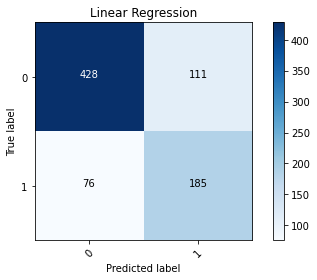

In [34]:
classes=list(set(y_test))
cm = confusion_matrix(y_test, y_test_pred_LR, labels=classes)
plot_confusion_matrix(cm, classes=classes, title='Linear Regression')
print(classification_report(y_test, y_test_pred_LR))


## Cross-validation (Repeated k-fold, linear regression)

In [35]:
from numpy import mean
from numpy import std
from sklearn.datasets import make_classification
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from functools import partial

# prepare the cross-validation procedure
cv = KFold(n_splits=20, random_state=1, shuffle=True)

# create model
model = LogisticRegression(random_state=44, solver='newton-cg', class_weight = 'balanced',max_iter = 1000, multi_class='auto')

# evaluate model
scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
F1scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)

# report performance
print('Accuracy: %.3f (%.3f)' % (mean(scores), std(scores)))
print('F1: %.3f (%.3f)' % (mean(F1scores), std(F1scores)))


Accuracy: 0.761 (0.031)
F1: 0.663 (0.036)


### Cross-validation Plot

>1 mean=0.6133 se=0.012


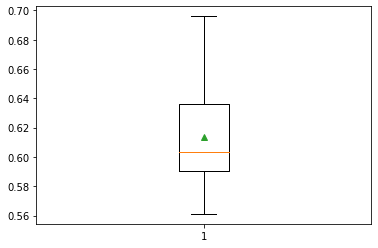

In [540]:

# compare the number of repeats for repeated k-fold cross-validation
from scipy.stats import sem
from numpy import mean
from numpy import std
from sklearn.datasets import make_classification
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from matplotlib import pyplot

def evaluate_model(X, y, repeats):
    # prepare the cross-validation procedure
    cv = RepeatedKFold(n_splits=10, n_repeats=repeats, random_state=1)
    
    # create model
    model = LogisticRegression(random_state=23, solver='newton-cg', max_iter = 2000, multi_class='auto')
    
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)
    return scores


# configurations to test
repeats = range(1,2)
results = list()
for r in repeats:
 # evaluate using a given number of repeats
    scores = evaluate_model(X, y, r)
 # summarize
    print('>%d mean=%.4f se=%.3f' % (r, mean(scores), sem(scores)))
 # store
    results.append(scores)
    
    
# plot the results
pyplot.boxplot(results, labels=[str(r) for r in repeats], showmeans=True)
pyplot.show()
 

## SVM

Confusion matrix, without normalization
              precision    recall  f1-score   support

           0       0.85      0.81      0.83       539
           1       0.64      0.70      0.67       261

    accuracy                           0.77       800
   macro avg       0.74      0.75      0.75       800
weighted avg       0.78      0.77      0.77       800



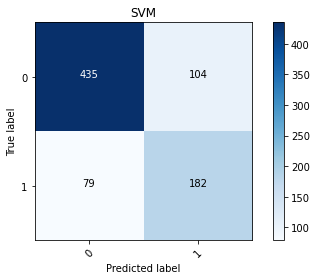

In [36]:
from sklearn import svm

model_SVM = svm.LinearSVC(random_state=222, dual = False, class_weight = 'balanced', multi_class='ovr').fit(X_train, y_train)
y_test_pred_SVM = model_SVM.predict(X_test)
classes=list(set(y_test))

cm = confusion_matrix(y_test, y_test_pred_SVM, labels=classes)
plot_confusion_matrix(cm, classes=classes, title='SVM')
print(classification_report(y_test, y_test_pred_SVM))

In [37]:
# prepare the cross-validation procedure
cv = KFold(n_splits=20, random_state=221, shuffle=True)

# create model
model = svm.LinearSVC(random_state=221, class_weight = 'balanced',dual = False, multi_class='ovr')

# evaluate model
scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
F1scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)

# report performance
print('Accuracy: %.3f (%.3f)' % (mean(scores), std(scores)))
print('F1: %.3f (%.3f)' % (mean(F1scores), std(F1scores)))

Accuracy: 0.762 (0.035)
F1: 0.660 (0.053)


>1 mean=0.6281 se=0.013


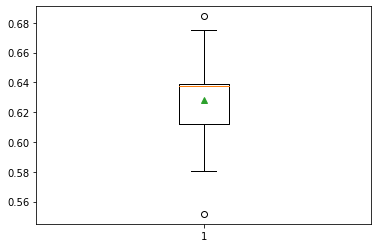

In [543]:
def evaluate_model(X, y, repeats):
    # prepare the cross-validation procedure
    cv = RepeatedKFold(n_splits=10, n_repeats=repeats, random_state=1)
    
    # create model
    model = svm.LinearSVC(random_state=53, dual = False, multi_class='ovr')
    
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)
    return scores


# configurations to test
repeats = range(1,2)
results = list()
for r in repeats:
 # evaluate using a given number of repeats
    scores = evaluate_model(X, y, r)
 # summarize
    print('>%d mean=%.4f se=%.3f' % (r, mean(scores), sem(scores)))
 # store
    results.append(scores)
    
    
# plot the results
pyplot.boxplot(results, labels=[str(r) for r in repeats], showmeans=True)
pyplot.show()

## Random Forest Classifier

Confusion matrix, without normalization
              precision    recall  f1-score   support

           0       0.75      0.93      0.83       539
           1       0.71      0.36      0.48       261

    accuracy                           0.74       800
   macro avg       0.73      0.64      0.65       800
weighted avg       0.74      0.74      0.72       800



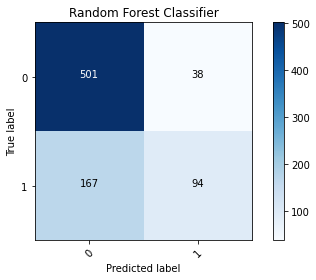

In [38]:
from sklearn.ensemble import RandomForestClassifier

model_RF = RandomForestClassifier(n_estimators=100, class_weight = 'balanced', random_state=215).fit(X_train, y_train)
y_test_pred_RF = model_RF.predict(X_test)
classes=list(set(y_test))

cm = confusion_matrix(y_test, y_test_pred_RF, labels=classes)
plot_confusion_matrix(cm, classes=classes, title='Random Forest Classifier')
print(classification_report(y_test, y_test_pred_RF))


In [39]:
# prepare the cross-validation procedure
cv = KFold(n_splits=20, random_state=1, shuffle=True)

# create model
model = RandomForestClassifier(n_estimators=100, class_weight = 'balanced', random_state=25)

# evaluate model
scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
F1scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)

# report performance
print('Accuracy: %.3f (%.3f)' % (mean(scores), std(scores)))
print('F1: %.3f (%.3f)' % (mean(F1scores), std(F1scores)))

Accuracy: 0.757 (0.026)
F1: 0.506 (0.058)


>1 mean=0.5100 se=0.018


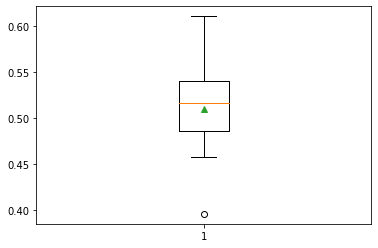

In [546]:
def evaluate_model(X, y, repeats):
    # prepare the cross-validation procedure
    cv = RepeatedKFold(n_splits=10, n_repeats=repeats, random_state=1)
    
    # create model
    model = RandomForestClassifier(n_estimators=50, random_state=25)
    
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)
    return scores


# configurations to test
repeats = range(1,2)
results = list()
for r in repeats:
 # evaluate using a given number of repeats
    scores = evaluate_model(X, y, r)
 # summarize
    print('>%d mean=%.4f se=%.3f' % (r, mean(scores), sem(scores)))
 # store
    results.append(scores)
    
    
# plot the results
pyplot.boxplot(results, labels=[str(r) for r in repeats], showmeans=True)
pyplot.show()

## Neural Networks

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  warnings.warn(


Confusion matrix, without normalization
              precision    recall  f1-score   support

           0       0.81      0.88      0.84       539
           1       0.70      0.56      0.62       261

    accuracy                           0.78       800
   macro avg       0.75      0.72      0.73       800
weighted avg       0.77      0.78      0.77       800



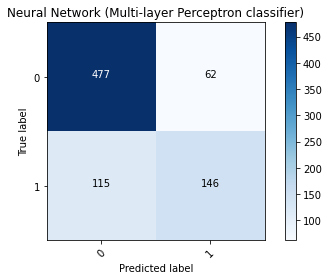

In [41]:
from sklearn.neural_network import MLPClassifier

model_NN = MLPClassifier(solver='adam', random_state=2115, max_iter = 50).fit(X_train, y_train)
y_test_pred_NN = model_NN.predict(X_test)
classes=list(set(y_test))

cm = confusion_matrix(y_test, y_test_pred_NN, labels=classes)
plot_confusion_matrix(cm, classes=classes, title='Neural Network (Multi-layer Perceptron classifier)')
print(classification_report(y_test, y_test_pred_NN))

In [42]:
# prepare the cross-validation procedure
cv = KFold(n_splits=5, random_state=100, shuffle=True)

# create model
model = MLPClassifier(solver='adam', random_state=2115, max_iter = 50)

# evaluate model
scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
F1scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)

# report performance
print('Accuracy: %.3f (%.3f)' % (mean(scores), std(scores)))
print('F1: %.3f (%.3f)' % (mean(F1scores), std(F1scores)))

Accuracy: 0.776 (0.010)
F1: 0.633 (0.025)


>1 mean=0.6260 se=0.011


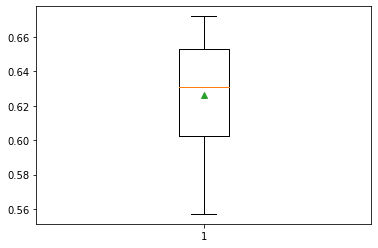

In [549]:
def evaluate_model(X, y, repeats):
    # prepare the cross-validation procedure
    cv = RepeatedKFold(n_splits=10, n_repeats=repeats, random_state=1)
    
    # create model
    model = MLPClassifier(solver='adam', random_state=25, max_iter = 50)
    
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)
    return scores


# configurations to test
repeats = range(1,2)
results = list()
for r in repeats:
 # evaluate using a given number of repeats
    scores = evaluate_model(X, y, r)
 # summarize
    print('>%d mean=%.4f se=%.3f' % (r, mean(scores), sem(scores)))
 # store
    results.append(scores)
    
    
# plot the results
pyplot.boxplot(results, labels=[str(r) for r in repeats], showmeans=True)
pyplot.show()

## Naive Bayes

Confusion matrix, without normalization
              precision    recall  f1-score   support

           0       0.89      0.52      0.65       539
           1       0.46      0.87      0.60       261

    accuracy                           0.63       800
   macro avg       0.68      0.69      0.63       800
weighted avg       0.75      0.63      0.64       800



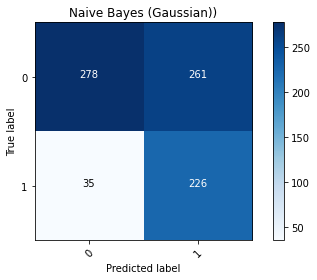

In [44]:
from sklearn.naive_bayes import GaussianNB

model_NB = GaussianNB().fit(X_train, y_train)
y_test_pred_NB = model_NB.predict(X_test)
classes=list(set(y_test))

cm = confusion_matrix(y_test, y_test_pred_NB, labels=classes)
plot_confusion_matrix(cm, classes=classes, title='Naive Bayes (Gaussian))')
print(classification_report(y_test, y_test_pred_NB))

In [551]:
# prepare the cross-validation procedure
cv = KFold(n_splits=20, random_state=100, shuffle=True)

# create model
model = GaussianNB()

# evaluate model
scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
F1scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)

# report performance
print('Accuracy: %.3f (%.3f)' % (mean(scores), std(scores)))
print('F1: %.3f (%.3f)' % (mean(F1scores), std(F1scores)))

Accuracy: 0.687 (0.039)
F1: 0.622 (0.044)


>1 mean=0.6121 se=0.007


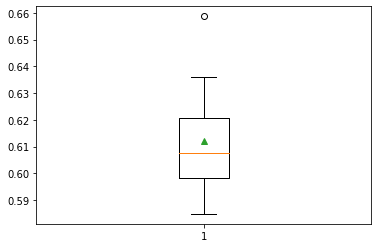

In [552]:
def evaluate_model(X, y, repeats):
    # prepare the cross-validation procedure
    cv = RepeatedKFold(n_splits=10, n_repeats=repeats, random_state=1)
    
    # create model
    model = GaussianNB()
    
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)
    return scores


# configurations to test
repeats = range(1,2)
results = list()
for r in repeats:
 # evaluate using a given number of repeats
    scores = evaluate_model(X, y, r)
 # summarize
    print('>%d mean=%.4f se=%.3f' % (r, mean(scores), sem(scores)))
 # store
    results.append(scores)
    
    
# plot the results
pyplot.boxplot(results, labels=[str(r) for r in repeats], showmeans=True)
pyplot.show()

## Nearest Neighbours

Confusion matrix, without normalization
              precision    recall  f1-score   support

           0       0.70      0.90      0.78       539
           1       0.48      0.19      0.27       261

    accuracy                           0.67       800
   macro avg       0.59      0.54      0.53       800
weighted avg       0.62      0.67      0.62       800



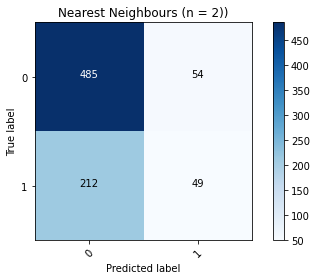

In [553]:
from sklearn.neighbors import KNeighborsClassifier

model_NNEIGH = KNeighborsClassifier(n_neighbors=5).fit(X_train, y_train)
y_test_pred_NNEIGH = model_NNEIGH.predict(X_test)
classes=list(set(y_test))

cm = confusion_matrix(y_test, y_test_pred_NNEIGH, labels=classes)
plot_confusion_matrix(cm, classes=classes, title='Nearest Neighbours (n = 2))')
print(classification_report(y_test, y_test_pred_NNEIGH))

In [554]:
# prepare the cross-validation procedure
cv = KFold(n_splits=20, random_state=1, shuffle=True)

# create model
model = KNeighborsClassifier(n_neighbors=2)

# evaluate model
scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
F1scores = cross_val_score(model, X, y, scoring='f1', cv=cv, n_jobs=-1)

# report performance
print('Accuracy: %.3f (%.3f)' % (mean(scores), std(scores)))
print('F1: %.3f (%.3f)' % (mean(F1scores), std(F1scores)))

Accuracy: 0.683 (0.022)
F1: 0.212 (0.045)


## Learning Curve, Scalability, Performance

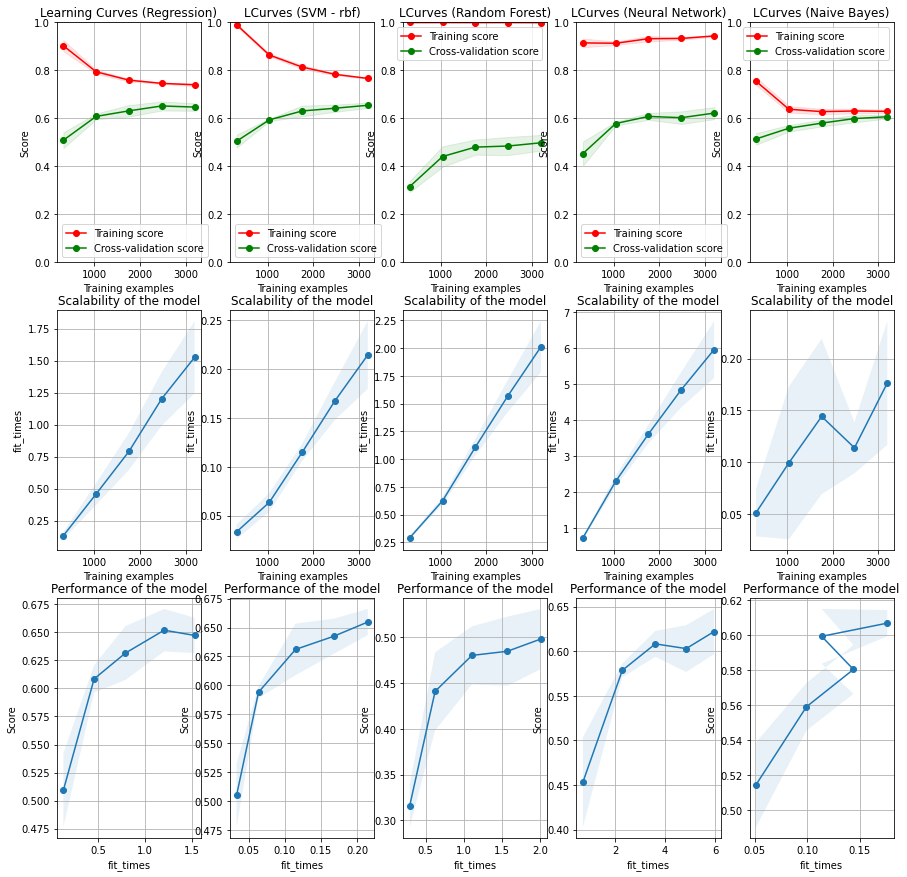

In [46]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit

#cv = KFold(n_splits=5, random_state=1, shuffle=True)

def plot_learning_curve(estimator, title, X, y, axes=None, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    if axes is None:
        _, axes = plt.subplots(1, 3, figsize=(20, 5))

    axes[0].set_title(title)
    if ylim is not None:
        axes[0].set_ylim(*ylim)
    axes[0].set_xlabel("Training examples")
    axes[0].set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
        learning_curve(estimator, X, y, cv=cv, n_jobs=n_jobs,
                       train_sizes=train_sizes,
                       return_times=True, scoring = 'f1')
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(train_sizes, train_scores_mean - train_scores_std,
                         train_scores_mean + train_scores_std, alpha=0.1,
                         color="r")
    axes[0].fill_between(train_sizes, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1,
                         color="g")
    axes[0].plot(train_sizes, train_scores_mean, 'o-', color="r",
                 label="Training score")
    axes[0].plot(train_sizes, test_scores_mean, 'o-', color="g",
                 label="Cross-validation score")
    axes[0].legend(loc="best")

    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, 'o-')
    axes[1].fill_between(train_sizes, fit_times_mean - fit_times_std,
                         fit_times_mean + fit_times_std, alpha=0.1)
    axes[1].set_xlabel("Training examples")
    axes[1].set_ylabel("fit_times")
    axes[1].set_title("Scalability of the model")

    # Plot fit_time vs score
    axes[2].grid()
    axes[2].plot(fit_times_mean, test_scores_mean, 'o-')
    axes[2].fill_between(fit_times_mean, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1)
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")

    return plt

fig, axes = plt.subplots(3, 5, figsize=(15, 15))

#X, y = load_digits(return_X_y=True)

title = "Learning Curves (Regression)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=23)

estimator = LogisticRegression(random_state=23, class_weight = 'balanced', solver='newton-cg', max_iter = 2000, multi_class='auto')
plot_learning_curve(estimator, title, X, y, axes=axes[:, 0], ylim=(0.0, 1.0),
                    cv=cv, n_jobs=4)


title = r"LCurves (SVM - rbf)"
# SVC is more expensive so we do a lower number of CV iterations:
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
estimator = svm.LinearSVC(random_state=53, class_weight = 'balanced',dual = False, multi_class='ovr')
#estimator = svm.SVC(random_state=53, kernel = 'rbf')
plot_learning_curve(estimator, title, X, y, axes=axes[:, 1], ylim=(0.0, 1.0),
                    cv=cv, n_jobs=4)


title = r"LCurves (Random Forest)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=23)
estimator = RandomForestClassifier(n_estimators=50, random_state=25)
plot_learning_curve(estimator, title, X, y, axes=axes[:, 2], ylim=(0.0, 1.0),
                    cv=cv, n_jobs=4)


title = r"LCurves (Neural Network)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
estimator = MLPClassifier(solver='adam', random_state=25, max_iter = 50)
plot_learning_curve(estimator, title, X, y, axes=axes[:, 3], ylim=(0.0, 1.0),
                    cv=cv, n_jobs=4)

title = r"LCurves (Naive Bayes)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
estimator = GaussianNB()
plot_learning_curve(estimator, title, X, y, axes=axes[:, 4], ylim=(0.0, 1.0),
                    cv=cv, n_jobs=4)


plt.show()

## Applying best model on test data

In [47]:
testtweets = 'PA_test_tweets.txt'

#TestTweets
data = []
with open(testtweets, "r", encoding="latin-1") as rawdata:
    data.append(rawdata.read())
    
#Split into lines by new line
for item in data: 
    byline = item.split('\n')

    
#Make lines into lists
linedata = []
for line in byline:
    splitlines = line.split(',',2)
    linedata.append(splitlines)
    
#Remove empty last item in the list
linedata = linedata[:-1]

#Clean
cleanedlinedata = []
for tweetid,timeofday,tweet in linedata:
    #NO URLS
    #noURL = re.sub(r"http\S+", "", tweet)
    
    #NO CONTRACTIONS
    noURL = re.sub(r"Ill", "I'll",  tweet)
    noCONTRACTIONS = contractions.fix(noURL)
    
    #NO ASCII
    encoded = noCONTRACTIONS.encode("ascii", "ignore")
    noASCII = encoded.decode()
   
    #NO Mentions with Parentheses
    #nomen = re.sub(r'\(@?\s.+\)', '', noASCII)
    
    #NO Mentions
    #nomen = re.sub(r'@\S+', '', noASCII)
    #nomen = re.sub(r'@\s\S+', '', nomen)
    
    #NO more new lines
    nonewlines = re.sub(r'\\n', '', noASCII)
    
    #NO capitalization
    nocaps = nonewlines.lower()
    
    #REMOVE quotationmarks
    noquote = nocaps.replace('"', '')
    
    #REMOVE duplicate punctuation
    remodup = re.sub(r'[.]+', '.', noquote)
    remodup = re.sub(r'[?]+', '?', remodup)
    remodup = re.sub(r'[!]+', '!', remodup)
    remodup = re.sub(r'[,]+', ',', remodup)
    remodup = re.sub(r'[_]+', '_', remodup)
    remodup = re.sub(r'\*', ' ', remodup)
    
    #numbers to words
    tokenizedsent = word_tokenize(remodup)
    wordified = []
    p = inflect.engine()
    for word in tokenizedsent:
        try:
            int(word)
            x = p.number_to_words(word)
            wordified.append(x)
        except ValueError:
            wordified.append(word)
    numtoword = ' '.join(wordified)

    
    #part of speech tag raw
    tokenizedsent = word_tokenize(numtoword)
    postokenizedsent = nltk.pos_tag(tokenizedsent)
    pos = []
    for word,tag in postokenizedsent:
        tag = str(word) + '_' + str(tag)
        pos.append(tag)
    postagged = ' '.join(pos)
    
    #lemmatizer
    lemma_function = WordNetLemmatizer()
    tokens = word_tokenize(numtoword)
    lemmaa = []
    for token, tag in pos_tag(tokens):
        lemma = lemma_function.lemmatize(token, tag_map[tag[0]])
        lemmaa.append(lemma)
    lemmaedsent = ' '.join(lemmaa)
    
    #part of speech tag lemma
    tokenizedsent = word_tokenize(lemmaedsent)
    postokenizedsent = nltk.pos_tag(tokenizedsent)
    pos = []
    for word,tag in postokenizedsent:
        tag = str(word) + '_' + str(tag)
        pos.append(tag)
    postaggedlemma = ' '.join(pos)
    
        
    
    final = [tweetid, timeofday, tweet, lemmaedsent, numtoword, postagged, postaggedlemma]
    cleanedlinedata.append(final)
    
    
print(cleanedlinedata)   


[['TweetID', 'TimeOfDay', 'Tweet', 'tweet', 'tweet', 'tweet_NN', 'tweet_NN'], ['5001', '19', '"MI Playmakers - Green 46, FABE 24, 5th Grade - Pool (B) #FAshowdown @exposurebball"', 'mi playmaker - green forty-six , fabe twenty-four , 5th grade - pool ( b ) # fashowdown @ exposurebball', 'mi playmakers - green forty-six , fabe twenty-four , 5th grade - pool ( b ) # fashowdown @ exposurebball', 'mi_NN playmakers_NNS -_: green_JJ forty-six_NN ,_, fabe_JJ twenty-four_NN ,_, 5th_CD grade_SYM -_: pool_NN (_( b_NN )_) #_# fashowdown_JJ @_NNP exposurebball_NN', 'mi_NN playmaker_NN -_: green_JJ forty-six_NN ,_, fabe_JJ twenty-four_NN ,_, 5th_CD grade_SYM -_: pool_NN (_( b_NN )_) #_# fashowdown_JJ @_NNP exposurebball_NN'], ['5002', '22', '"I biked 2.46 mi with @mapmyride. Check out my route in Waterford, MI, United States! https://t.co/rWBtjOSufx #bike #cycling"', 'i bike 2.46 mi with @ mapmyride . check out my route in waterford , mi , united state ! http : //t.co/rwbtjosufx # bike # cycling', 

In [48]:
fordepextraction = []
for tweetid, timeofday, tweet, lemmaedsent, numtoword, postagged, postaggedlemma in cleanedlinedata:
    fordepextraction.append(numtoword)

fordepextraction[:10]

['tweet',
 'mi playmakers - green forty-six , fabe twenty-four , 5th grade - pool ( b ) # fashowdown @ exposurebball',
 'i biked 2.46 mi with @ mapmyride . check out my route in waterford , mi , united states ! https : //t.co/rwbtjosufx # bike # cycling',
 '@ jacob_nash yes i do , it is just i said hi bestfriend in the hallway and you ignored me and walked away : (',
 "countless hours of house hunting has taught me that realtors have a different definition of 'super sharp ' than i do .",
 'one year ago today , nik wallenda walked across the grand canyon on a high wire ! ( via @ timehop ) http : //t.co/8vgjwpw5tb',
 'great day for baseball practice and ice cream . http : //t.co/jfxchg2rnf',
 'imma cook for him today : )',
 "i liked anna sassin 's performance the most tonight , because i am just immature enough to really enjoy glow-in-the-dark hula hoops .",
 'photo walk . ( @ still point zen buddhist temple w/ @ zenbija ) http : //t.co/4vtiwchvdz']

In [49]:
##Join to make pipeline faster
fordep = '\n\n'.join(fordepextraction)
#Remove punctuations
noperiod = fordep.translate(str.maketrans('', '', string.punctuation))

In [50]:
%%time

#dependency info
nlp = stanza.Pipeline('en', tokenize_no_ssplit=True)
#doc = nlp(noperiodsample)
doc = nlp(noperiod)
#doc = nlp('\n\n God \n\n Manila ')

#SENTIMENTFOCUS
sentiment = []
for item in doc.sentences:
    it = item.sentiment
    sentiment.append(it)
    
#DEPENDENCY FOCUS
sentdep = []
for item in doc.sentences:
    it = item.to_dict()
    sentdep.append(it)


#SENTIMENT
sentimentt = []
for idx,sentencesent in enumerate(sentiment):
    if sentencesent == 0:
        sentimentt.append([idx+5000, '-1'])
    elif sentencesent == 1:
        sentimentt.append([idx+5000, '0'])
    elif sentencesent == 2:
        sentimentt.append([idx+5000, '1'])
    else:
        sentimentt.append('NA')


#Get MAIN SUBJECT 
subject = []
for idx,sentence in enumerate(sentdep):
    sentencesubj = []
    for dct in sentence:
        if len(sentencesubj) == 0:
            if dct['deprel'] == 'nsubj' or dct['deprel'] == 'subj':
                mv = dct['lemma'].lower()
                sentencesubj.append(idx+5000)
                sentencesubj.append(mv)
            else:
                pass
        else:
            pass
    
    if str(sentencesubj) == '[]':
        subject.append([idx+5000, 'NA'])
    else:
        subject.append(sentencesubj)

#Get MAIN SUBJECT ENTITY NAME TYPE
subjectner = []
for idx,sentence in enumerate(sentdep):
    sentencesubjentity = []
    for dct in sentence:
        if len(sentencesubjentity) == 0:
            if dct['deprel'] == 'nsubj' or dct['deprel'] == 'subj' :
                if dct['ner'] != 'O':
                    mv = dct['ner']
                    sentencesubjentity.append(idx+5000)
                    sentencesubjentity.append(mv)
                else:
                    pass
            else:
                pass
        else:
            pass
    if str(sentencesubjentity) == '[]':
        subjectner.append([idx+5000, 'NA'])
    else:
        subjectner.append(sentencesubjentity)
        

#Get ALL SUBJECTS 
allsubject = []
for idx,sentence in enumerate(sentdep):
    sentencesubj = []
    for dct in sentence:
        if dct['deprel'] == 'nsubj' or dct['deprel'] == 'subj' or dct['deprel'] == 'conj' :
            mv = dct['lemma'].lower()
            sentencesubj.append(mv)
        else:
            pass
    
    if str(sentencesubj) == '[]':
        allsubject.append([idx+5000, 'NA'])
    else:
        allsubject.append([idx+5000, sentencesubj])

#Get ALL SUBJECTS ENTITY TYPE 
allsubjectner = []
for idx,sentence in enumerate(sentdep):
    sentencesubjent = []
    for dct in sentence:
        if dct['deprel'] == 'nsubj' or dct['deprel'] == 'subj' or dct['deprel'] == 'conj' :
            if dct['ner'] != 'O':
                mv = dct['ner']
                sentencesubjent.append(mv)
            else:
                sentencesubjent.append('NA')
        else:
            pass
    
    if str(sentencesubjent) == '[]':
        allsubjectner.append([idx+5000, 'NA'])
    else:
        allsubjectner.append([idx+5000, sentencesubjent])
        

#Get OBJECT
obj = []
for idx,sentence in enumerate(sentdep):
    sentenceobj = []
    for dct in sentence:
        if len(sentenceobj) == 0:
            if dct['deprel'] == 'dobj' or dct['deprel'] == 'iobj' or dct['deprel'] == 'pobj' or dct['deprel'] == 'obj':
                mv = dct['lemma'].lower()
                sentenceobj.append(idx+5000)
                sentenceobj.append(mv)
            else:
                pass
        else:
            pass
    if str(sentenceobj) == '[]':
        obj.append([idx+5000, 'NA'])
    else:
        obj.append(sentenceobj)

#Get OBJECT ENTITY TYPE
objner = []
for idx,sentence in enumerate(sentdep):
    sentenceobjent = []
    for dct in sentence:
        if len(sentenceobjent) == 0:
            if dct['deprel'] == 'dobj' or dct['deprel'] == 'iobj' or dct['deprel'] == 'pobj' or dct['deprel'] == 'obj':
                if dct['ner'] != 'O':
                    mv = dct['ner']
                    sentenceobjent.append(idx+5000)
                    sentenceobjent.append(mv)            
                else:
                    pass
            else:
                pass
        else:
            pass
    
    if str(sentenceobjent) == '[]':
        objner.append([idx+5000, 'NA'])
    else:
        objner.append(sentenceobjent)

    
#Get NEGATION WORD
negw = []
for idx,sentence in enumerate(sentdep):
    sentencenegw = []
    for dct in sentence:
        if dct['deprel'] == 'advmod':
            if dct['text'] in ['never', 'not', 'no', 'nt']:
                sentencenegw.append([idx+5000, dct['text']])
            else:
                pass
        else:
            pass
        
    if str(sentencenegw) == '[]':
        negw.append([idx+5000, 'NA'])
    else:
        negw.append(sentencenegw[0])

    
        
    
    
#Get MAIN VERBS
mainverbs = []
for idx,sentence in enumerate(sentdep):
    sentencemainverb = []
    for dct in sentence:
        if dct['deprel'] == 'root':
            mv = dct['lemma'].lower()
            sentencemainverb.append(idx+5000)
            sentencemainverb.append(mv)
        else:
            pass
    mainverbs.append(sentencemainverb)

    
    
#GET MAIN VERB INFORMATION = TENSE
mainverbtense = []
for idx,sentence in enumerate(sentdep):

    for dct in sentence:
        if dct['deprel'] == 'root':
            try:
                mv = str(dct['feats'].lower())
                sentencemainverbinfo = mv.split('|')
                featuredic = {}
                for entry in sentencemainverbinfo:
                    x = entry.split('=')
                    featuredic[x[0]] = x[1]
            except KeyError:
                pass
        else:
            pass
    
    try:
        mainverbtense.append([idx+5000,featuredic['tense']])        
    except KeyError:
        mainverbtense.append([idx+5000, 'NA'])  

            
#GET MAIN VERB INFORMATION = MOOD
mainverbmood = []
for idx,sentence in enumerate(sentdep):

    for dct in sentence:
        if dct['deprel'] == 'root':
            try:
                mv = str(dct['feats'].lower())
                sentencemainverbinfo = mv.split('|')
                featuredic = {}
                for entry in sentencemainverbinfo:
                    x = entry.split('=')
                    featuredic[x[0]] = x[1]
            except KeyError:
                pass
        else:
            pass
    
    try:
        mainverbmood.append([idx+5000,featuredic['mood']] )  
    except KeyError:
        mainverbmood.append([idx+5000,'NA'] )  
        

#GET MAIN VERB INFORMATION = MOOD
mainverbform= []
for idx,sentence in enumerate(sentdep):

    for dct in sentence:
        if dct['deprel'] == 'root':
            try:
                mv = str(dct['feats'].lower())
                sentencemainverbinfo = mv.split('|')
                featuredic = {}
                for entry in sentencemainverbinfo:
                    x = entry.split('=')
                    featuredic[x[0]] = x[1]
            except KeyError:
                pass
        else:
            pass
    
    try:
        mainverbform.append([idx+5000,featuredic['verbform']] ) 
    except KeyError:
        mainverbform.append([idx+5000, 'NA']) 
        
#GET MAIN VERB INFORMATION = NUMBER
mainverbnum= []
for idx,sentence in enumerate(sentdep):

    for dct in sentence:
        if dct['deprel'] == 'root':
            try:
                mv = str(dct['feats'].lower())
                sentencemainverbinfo = mv.split('|')
                featuredic = {}
                for entry in sentencemainverbinfo:
                    x = entry.split('=')
                    featuredic[x[0]] = x[1]
            except KeyError:
                pass
        else:
            pass
    
    try:
        mainverbnum.append([idx+5000,featuredic['number']] ) 
    except KeyError:
        mainverbnum.append([idx+5000,'NA']) 
   
        
        
#Get ALL VERBS
verbs = []
for idx,sentence in enumerate(sentdep):
    sentenceverb = []
    for dct in sentence:
        if dct['upos'] == 'VERB':
            xs = dct['lemma'].lower()
            sentenceverb.append(xs) 
        else:
            pass
    if str(sentenceverb) == '[]':
        verbs.append([idx+5000, 'NA'])
    else:
        verbs.append([idx+5000, [', '.join(sentenceverb)]])
        
    

#Get ALL ENTITY NAMES 
allentitynames = []
for idx,sentence in enumerate(sentdep):
    sentenceent = []
    for dct in sentence:
        if dct['ner'] != 'O':
            sentenceent.append(dct['text'])
        else:
            pass
    
    if str(sentenceent) == '[]':
        allentitynames.append([idx+5000, 'NA'])
    else:
        allentitynames.append([idx+5000,sentenceent])

#Get ALL ENTITY NAMES 
allentityner = []
for idx,sentence in enumerate(sentdep):
    sentenceent = []
    for dct in sentence:
        if dct['ner'] != 'O':
            sentenceent.append(dct['ner'])
        else:
            pass
    
    if str(sentenceent) == '[]':
        allentityner.append([idx+5000, 'NA'])
    else:
        allentityner.append([idx+5000,sentenceent])



2021-03-22 14:03:18 INFO: Loading these models for language: en (English):
| Processor | Package   |
-------------------------
| tokenize  | combined  |
| pos       | combined  |
| lemma     | combined  |
| depparse  | combined  |
| sentiment | sstplus   |
| ner       | ontonotes |

2021-03-22 14:03:18 INFO: Use device: cpu
2021-03-22 14:03:18 INFO: Loading: tokenize
2021-03-22 14:03:18 INFO: Loading: pos
2021-03-22 14:03:19 INFO: Loading: lemma
2021-03-22 14:03:19 INFO: Loading: depparse
2021-03-22 14:03:20 INFO: Loading: sentiment
2021-03-22 14:03:21 INFO: Loading: ner
2021-03-22 14:03:23 INFO: Done loading processors!


CPU times: user 1min 38s, sys: 15.4 s, total: 1min 53s
Wall time: 1min 56s


In [51]:
forstoring = [sentimentt, subject, subjectner, allsubject, allsubjectner, negw, mainverbs, mainverbtense, mainverbmood, mainverbnum, mainverbform, obj, objner, verbs, allentitynames, allentityner]

for item in forstoring:
    print(item)



#TO CHECK IF LENGTH THE SAME
#for idx,item in enumerate(forstoring):
#    for token in item:
#        if len(token) != 2:
#            print(idx)
#            print(token)
#        else:
#            pass

#obj[2805]
#objner[2805]



[[5000, '0'], [5001, '0'], [5002, '0'], [5003, '-1'], [5004, '0'], [5005, '0'], [5006, '1'], [5007, '0'], [5008, '1'], [5009, '0'], [5010, '0'], [5011, '1'], [5012, '-1'], [5013, '0'], [5014, '0'], [5015, '-1'], [5016, '0'], [5017, '0'], [5018, '0'], [5019, '1'], [5020, '0'], [5021, '1'], [5022, '0'], [5023, '-1'], [5024, '0'], [5025, '0'], [5026, '1'], [5027, '-1'], [5028, '0'], [5029, '0'], [5030, '-1'], [5031, '0'], [5032, '0'], [5033, '-1'], [5034, '1'], [5035, '0'], [5036, '0'], [5037, '0'], [5038, '-1'], [5039, '1'], [5040, '0'], [5041, '0'], [5042, '-1'], [5043, '1'], [5044, '0'], [5045, '0'], [5046, '-1'], [5047, '0'], [5048, '0'], [5049, '0'], [5050, '0'], [5051, '0'], [5052, '-1'], [5053, '-1'], [5054, '0'], [5055, '0'], [5056, '0'], [5057, '0'], [5058, '0'], [5059, '0'], [5060, '-1'], [5061, '0'], [5062, '-1'], [5063, '0'], [5064, '1'], [5065, '-1'], [5066, '-1'], [5067, '0'], [5068, '0'], [5069, '0'], [5070, '0'], [5071, '0'], [5072, '0'], [5073, '1'], [5074, '-1'], [5075, 

In [52]:
noheaderdata = cleanedlinedata[1:]
datmaster = DataFrame(noheaderdata,columns=['tweetid','timeofday','tweetorig','tweetlemma','tweetcleaned','tweetpos','tweetposlemma'])

dmaster = datmaster

dmaster.tail()



,tweetid,timeofday,tweetorig,tweetlemma,tweetcleaned,tweetpos,tweetposlemma
995,5996,22,When you wonder why people are staring and you then you realize you've been walking with your backpack wide open for 20 minutes,when you wonder why people be star and you then you realize you have be walk with your backpack wide open for twenty minute,when you wonder why people are staring and you then you realize you have been walking with your backpack wide open for twenty minutes,when_WRB you_PRP wonder_VBP why_WRB people_NNS are_VBP staring_VBG and_CC you_PRP then_RB you_PRP realize_VBP you_PRP have_VBP been_VBN walking_VBG with_IN your_PRP$ backpack_NN wide_JJ open_JJ for_IN twenty_NN minutes_NNS,when_WRB you_PRP wonder_VBP why_WRB people_NNS be_VB star_VBN and_CC you_PRP then_RB you_PRP realize_VBP you_PRP have_VBP be_VB walk_VBN with_IN your_PRP$ backpack_NN wide_JJ open_JJ for_IN twenty_NN minute_NN
996,5997,7,Brutal killing of a samba queen exposes dark world behind the glitter of carnival\n\nhttp://t.co/4KwKa2tN6g,brutal killing of a samba queen expose dark world behind the glitter of carnivalhttp : //t.co/4kwka2tn6g,brutal killing of a samba queen exposes dark world behind the glitter of carnivalhttp : //t.co/4kwka2tn6g,brutal_JJ killing_NN of_IN a_DT samba_NN queen_JJ exposes_NNS dark_JJ world_NN behind_IN the_DT glitter_NN of_IN carnivalhttp_NN :_: //t.co/4kwka2tn6g_NN,brutal_JJ killing_NN of_IN a_DT samba_NN queen_NN expose_RB dark_JJ world_NN behind_IN the_DT glitter_NN of_IN carnivalhttp_NN :_: //t.co/4kwka2tn6g_NN
997,5998,1,"""You're so cavalier, because you're lost before you're running away. We need you here in the heart shaped state.Ê__""","you be so cavalier , because you be lose before you be run away . we need you here in the heart shape state._","you are so cavalier , because you are lost before you are running away . we need you here in the heart shaped state._","you_PRP are_VBP so_RB cavalier_RB ,_, because_IN you_PRP are_VBP lost_VBN before_IN you_PRP are_VBP running_VBG away_RB ._. we_PRP need_VBP you_PRP here_RB in_IN the_DT heart_NN shaped_VBD state.__NN","you_PRP be_VB so_RB cavalier_JJ ,_, because_IN you_PRP be_VB lose_VBN before_IN you_PRP be_VB run_VBN away_RB ._. we_PRP need_VBP you_PRP here_RB in_IN the_DT heart_NN shape_NN state.__NN"
998,5999,2,House hunting is on hold for a little bit ¨ü__,house hunting be on hold for a little bit _,house hunting is on hold for a little bit _,house_NN hunting_NN is_VBZ on_IN hold_NN for_IN a_DT little_JJ bit_NN __JJ,house_NN hunting_VBG be_VB on_IN hold_NN for_IN a_DT little_JJ bit_NN __JJ
999,6000,14,Never put on cologne right after getting a beard trim .....ouch ! #notefortheday,never put on cologne right after get a beard trim .ouch ! # notefortheday,never put on cologne right after getting a beard trim .ouch ! # notefortheday,never_RB put_VBN on_IN cologne_NN right_NN after_IN getting_VBG a_DT beard_NN trim_NN .ouch_JJ !_. #_# notefortheday_JJ,never_RB put_VBN on_IN cologne_NN right_NN after_IN get_VB a_DT beard_NN trim_NN .ouch_JJ !_. #_# notefortheday_JJ


In [53]:
forstoring2 = ['sentimentt', 'subject', 'subjectner', 'allsubject', 'allsubjectner', 'negw', 'mainverbs', 'mainverbtense', 'mainverbmood', 'mainverbnum', 'mainverbform', 'obj', 'objner', 'verbs', 'allentitynames', 'allentityner']
forstoring = [sentimentt, subject, subjectner, allsubject, allsubjectner, negw, mainverbs, mainverbtense, mainverbmood, mainverbnum, mainverbform, obj, objner, verbs, allentitynames, allentityner]
dicname = {}
for idx, item in enumerate(forstoring2):
    dicname[idx] = item
for idx, item in enumerate(forstoring):
    x = item[1:]
    datlabels = DataFrame(x, columns = ['tweetid', dicname[idx]])
    datlabels['tweetid'] = datlabels['tweetid'].astype(int)
    dmaster['tweetid'] = dmaster['tweetid'].astype(int)
    dmaster = pd.merge(dmaster, datlabels, on = 'tweetid' )





In [54]:
datfeat2 = dmaster

### Feature - length of tweet
datfeat2['lentweet'] = datfeat2['tweetlemma'].str.count(' ') + 1

### Feature - Hyponyms of sport - lexsport
from nltk.corpus import wordnet as wn
sport = wn.synset('sport.n.01')
typesOfsport = list(set([w for s in sport.closure(lambda s:s.hyponyms()) for w in s.lemma_names()]))

sporttype = []
lemma_function = WordNetLemmatizer()
for token, tag in pos_tag(typesOfsport):
    x = token.replace("_", " ").replace("-", " ")
    lemma = lemma_function.lemmatize(x, tag_map[tag[0]])
    y = lemma.split(' ')
    z = token.replace("_", " ").replace("-", " ").split(' ')
    for item in y:
        lem = lemma_function.lemmatize(item, tag_map[tag[0]])
        sporttype.append(lem)   
    for item in z:
        sporttype.append(item)

lexsport = []
for token, tag in pos_tag(sporttype):
    if tag == 'CD' or tag == 'DT':
        pass
    else:
        lexsport.append(token)
lexsport = list(set(lexsport))
pattern = '|'.join(lexsport)
import numpy as np

datfeat2['verbsstr'] = datfeat.verbs.apply(str)

datfeat2['lexsport'] = np.where(((datfeat2.tweetlemma.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexsportverb'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexsportmv'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexsportobj'] = np.where(((datfeat2.obj.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)


### Feature - Passive

synonyms = []
#morepass = 'To increase  broaden     enlarge     exceed     expand  generate     improve     maximize     optimize  To decrease  decline     deteriorate     erode     minimize  narrow     reduce     worsen  Difference or variance     alter     contrast     convert     deviate   differ     differentiate     distinguish     diverge  evolve     modify     revise     transform  Stability  maintain     sustain  Keeping within a certain range/ under a certain level   confine     inhibit     prohibit     restrict  In-depth study  analyze     examine    investigate     observe survey  Stating Ideas/Concepts     acknowledge      argue     attribute     comment        propose  establish     identify     mention     note     observe      state  Restating Ideas/Concepts  elaborate    expand  Emphasizing Ideas/Concepts  emphasize      stress  Describe phenomena  acquire     define     impact      signify       symbolize  Describe data  approximate      demonstrate        indicate  levels off      reflect  Stating positive position  advocate         hypothesize       propose  Stating negative position/to contradict  deny      dispute    negate     reject      Uncertainty  predict      speculate  Extrapolation of information  deduce     imply     infer     project  Show components  comprise     consist      constitute       incorporate'
#tok = word_tokenize(morepass)
 
words = ['improve', 'maximize', 'watch', 'sit', 'know', 'compute', 'say', 'argue', 'think', 'lay', 'rest', 'put', 'receive', 'put on', 'taste', 'touch', 'see', 'smell', 'hear', 'listen']

#words = tok+words

for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)
            
syn = (set(synonyms))
pattern = '|'.join(syn)
datfeat2['verbsstr'] = datfeat2.verbs.apply(str)


datfeat2['mvpassive'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['vbpassive'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)



### NEW Feature - Feeling or Thinking or Emotion
synonyms = []
words = ['think', 'feel', 'believe', 'opine', 'consider']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))

pattern = '|'.join(syn)
datfeat2['verbsstr'] = datfeat2.verbs.apply(str)
datfeat2['mvfeelthinkemo'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['vbfeelthinkemo'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)

### NEW Feature - Feeling
synonyms = []
words = ['feel']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))

pattern = '|'.join(syn)
datfeat2['verbsstr'] = datfeat2.verbs.apply(str)
datfeat2['mvfeel'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['vbfeel'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)

### NEW Feature - Thinking
synonyms = []
words = ['think']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))

pattern = '|'.join(syn)
datfeat2['verbsstr'] = datfeat2.verbs.apply(str)
datfeat2['mvthink'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['vbthink'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)

### NEW Feature - Believe
synonyms = []
words = ['believe']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))

pattern = '|'.join(syn)
datfeat2['verbsstr'] = datfeat2.verbs.apply(str)
datfeat2['mvbelieve'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['vbbelieve'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)

### NEW Feature - tired
synonyms = []
words = ['tired', 'exhausted', 'exhaustion', 'fatigue', 'sweat']
for idx, word in enumerate(words):
    for syn in wn.synsets(word): 
        for l in syn.lemmas():
            x = str(l.name()).replace("-", "").split('_')
            for item in x:
                synonyms.append(item)          
syn = (set(synonyms))
print(syn)
pattern = '|'.join(syn)
datfeat2['verbsstr'] = datfeat2.verbs.apply(str)
datfeat2['mvtired'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['vbtired'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['tweettired'] = np.where(((datfeat2.tweetlemma.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)





### NEW Feature - Hyponyms of feelings - lexemotions
from nltk.corpus import wordnet as wn
emotion = wn.synset('emotion.n.01')
typesOfemotion = list(set([w for s in emotion.closure(lambda s:s.hyponyms()) for w in s.lemma_names()]))


emotiontype = []
lemma_function = WordNetLemmatizer()
for token, tag in pos_tag(typesOfemotion):
    x = token.replace("_", " ").replace("-", " ")
    lemma = lemma_function.lemmatize(x, tag_map[tag[0]])
    y = lemma.split(' ')
    z = token.replace("_", " ").replace("-", " ").split(' ')
    for item in y:
        lem = lemma_function.lemmatize(item, tag_map[tag[0]])
        emotiontype.append(lem)   
    for item in z:
        emotiontype.append(item)

lexemotion = []
for token, tag in pos_tag(emotiontype):
    if tag == 'VBZ' or tag == 'VBD' or tag == 'VBP' or tag == 'VBG' or tag == 'VBN':
        lexemotion.append(token)
    else:
        pass

lexemotion = set(lexemotion)
pattern = '|'.join(lexemotion)


lexemotionnoun = []
for token, tag in pos_tag(emotiontype):
    if tag == 'NN':
        lexemotionnoun.append(token)
    else:
        pass

lexemotionnoun = set(lexemotionnoun)
pattern2 = '|'.join(lexemotionnoun)
    
datfeat2['lexemotion'] = np.where(((datfeat2.tweetlemma.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexemotionverb'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexemotionmv'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexemotionobj'] = np.where(((datfeat2.obj.str.contains(pattern2)) & (datfeat2['negw'] == 'NA')), 1, 0)







### Feature - Hyponyms of activity - lexactivity
from nltk.corpus import wordnet as wn
activity = wn.synset('activity.n.01')
typesOfactivity = list(set([w for s in activity.closure(lambda s:s.hyponyms()) for w in s.lemma_names()]))

acttype = []
lemma_function = WordNetLemmatizer()
for token, tag in pos_tag(typesOfactivity):
    x = token.replace("_", " ").replace("-", " ")
    lemma = lemma_function.lemmatize(x, tag_map[tag[0]])
    y = lemma.split(' ')
    z = token.replace("_", " ").replace("-", " ").split(' ')
    for item in y:
        lem = lemma_function.lemmatize(item, tag_map[tag[0]])
        acttype.append(lem)   
    for item in z:
        acttype.append(item)

lexact = []
for token, tag in pos_tag(acttype):
    if tag == 'VBZ' or tag == 'VBD' or tag == 'VBP' or tag == 'VBG' or tag == 'VBN':
        lexact.append(token)
    else:
        pass

lexact = set(lexact)
pattern = '|'.join(lexact)


lexactnoun = []
for token, tag in pos_tag(acttype):
    if tag == 'NN':
        lexactnoun.append(token)
    else:
        pass

lexactnoun = set(lexactnoun)
pattern2 = '|'.join(lexactnoun)
    
datfeat2['lexact'] = np.where(((datfeat2.tweetlemma.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexactverb'] = np.where(((datfeat2.verbsstr.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexactmv'] = np.where(((datfeat2.mainverbs.str.contains(pattern)) & (datfeat2['negw'] == 'NA')), 1, 0)
datfeat2['lexactobj'] = np.where(((datfeat2.obj.str.contains(pattern2)) & (datfeat2['negw'] == 'NA')), 1, 0)

### PERSONAL PRONOUN I
regex = r'i'
datfeat2['perspronoun'] = np.where(datfeat2.subject.str.contains(regex), 1, 0)

### PAST
regex = r'past'
datfeat2['mvpast'] = np.where(datfeat2.mainverbtense.str.contains(regex), 1, 0)

### PRESENT
regex = r'pres'
datfeat2['mvpres'] = np.where(datfeat2.mainverbtense.str.contains(regex), 1, 0)

##PERSON
regex = r'PERSON'
datfeat2['typ'] = datfeat2.allentityner.apply(str)
datfeat2['person'] = np.where(datfeat2.typ.str.contains(regex), 1, 0)


##NEGATION
regex = r'NA'
datfeat2['negation'] = datfeat2.negw.apply(str)
datfeat2['negation'] = np.where(datfeat2.negation.str.contains(regex), 0, 1)


##SUBJECT
datfeat2['hassubject'] = datfeat2.subject.apply(str)
datfeat2['hassubject'] = np.where(datfeat2.hassubject.str.contains('NA'), 0, 1)

##OBJECT
datfeat2['hasobject'] = datfeat2.obj.apply(str)
datfeat2['hasobject'] = np.where(datfeat2.hasobject.str.contains('NA'), 0, 1)

##VERB
datfeat2['hasverb'] = datfeat2.verbsstr.apply(str)
datfeat2['hasverb'] = np.where(datfeat2.hasverb.str.contains('NA'), 0, 1)

                              
                              
### REGEX REGULAR
#regex = r' a '
#datfeat['three'] = np.where(datfeat.tweetcleaned.str.contains(regex), 1, 0)

datfeat2.head()


{'jade', 'tired', 'use', 'commonplace', 'expel', 'upon', 'banal', 'exertion', 'exhaustion', 'hackneyed', 'fag', 'worn', 'timeworn', 'run', 'perspiration', 'fatigue', 'grease', 'sap', 'consume', 'out', 'wear', 'played', 'exhausted', 'fagged', 'eat', 'tiredness', 'eject', 'tucker', 'threadbare', 'down', 'fret', 'wellworn', 'effort', 'elbow', 'debilitation', 'enervation', 'travail', 'wipe', 'deplete', 'oldhat', 'spent', 'up', 'through', 'wornout', 'duty', 'swither', 'washedout', 'play', 'lather', 'perspire', 'wash', 'sweat', 'tire', 'stock', 'release', 'fatigued', 'beat', 'weary', 'weariness', 'exhaust', 'outwear', 'shopworn', 'trite', 'bore', 'stew', 'enfeeblement', 'discharge', 'dogtired', 'pall', 'sudor', 'sudate'}


,tweetid,timeofday,tweetorig,tweetlemma,tweetcleaned,tweetpos,tweetposlemma,sentimentt,subject,subjectner,allsubject,allsubjectner,negw,mainverbs,mainverbtense,mainverbmood,mainverbnum,mainverbform,obj,objner,verbs,allentitynames,allentityner,lentweet,verbsstr,lexsport,lexsportverb,lexsportmv,lexsportobj,mvpassive,vbpassive,mvfeelthinkemo,vbfeelthinkemo,mvfeel,vbfeel,mvthink,vbthink,mvbelieve,vbbelieve,mvtired,vbtired,tweettired,lexemotion,lexemotionverb,lexemotionmv,lexemotionobj,lexact,lexactverb,lexactmv,lexactobj,perspronoun,mvpast,mvpres,typ,person,negation,hassubject,hasobject,hasverb
0,5001,19,"""MI Playmakers - Green 46, FABE 24, 5th Grade - Pool (B) #FAshowdown @exposurebball""","mi playmaker - green forty-six , fabe twenty-four , 5th grade - pool ( b ) # fashowdown @ exposurebball","mi playmakers - green forty-six , fabe twenty-four , 5th grade - pool ( b ) # fashowdown @ exposurebball","mi_NN playmakers_NNS -_: green_JJ forty-six_NN ,_, fabe_JJ twenty-four_NN ,_, 5th_CD grade_SYM -_: pool_NN (_( b_NN )_) #_# fashowdown_JJ @_NNP exposurebball_NN","mi_NN playmaker_NN -_: green_JJ forty-six_NN ,_, fabe_JJ twenty-four_NN ,_, 5th_CD grade_SYM -_: pool_NN (_( b_NN )_) #_# fashowdown_JJ @_NNP exposurebball_NN",0,mi,NA,[mi],[NA],NA,playmaker,pres,ind,sing,fin,exposurebball,NA,[playmaker],[5th],[S-ORDINAL],20,['playmaker'],1,1,1,1,1,1,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,1,1,1,1,1,0,1,['S-ORDINAL'],0,0,1,1,1
1,5002,22,"""I biked 2.46 mi with @mapmyride. Check out my route in Waterford, MI, United States! https://t.co/rWBtjOSufx #bike #cycling""","i bike 2.46 mi with @ mapmyride . check out my route in waterford , mi , united state ! http : //t.co/rwbtjosufx # bike # cycling","i biked 2.46 mi with @ mapmyride . check out my route in waterford , mi , united states ! https : //t.co/rwbtjosufx # bike # cycling","i_NN biked_VBD 2.46_CD mi_NN with_IN @_NNP mapmyride_NN ._. check_VB out_IN my_PRP$ route_NN in_IN waterford_NN ,_, mi_NN ,_, united_JJ states_NNS !_. https_NN :_: //t.co/rwbtjosufx_JJ #_# bike_NN #_# cycling_NN","i_NN bike_VBP 2.46_CD mi_NN with_IN @_NNP mapmyride_NN ._. check_VB out_IN my_PRP$ route_NN in_IN waterford_NN ,_, mi_NN ,_, united_JJ state_NN !_. http_NN :_: //t.co/rwbtjosufx_JJ #_# bike_NN #_# cycling_NN",0,i,NA,[i],[NA],NA,bike,past,ind,NA,fin,mi,E-QUANTITY,"[bike, check]","[246, mi]","[B-QUANTITY, E-QUANTITY]",27,"['bike, check']",1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,1,0,"['B-QUANTITY', 'E-QUANTITY']",0,0,1,1,1
2,5003,20,"""@Jacob_Nash yes I do, it's just I said hi Bestfriend In the hallway and you ignored me and walked away:(""","@ jacob_nash yes i do , it be just i say hi bestfriend in the hallway and you ignore me and walk away : (","@ jacob_nash yes i do , it is just i said hi bestfriend in the hallway and you ignored me and walked away : (","@_JJ jacob_nash_NN yes_NNS i_RB do_VBP ,_, it_PRP is_VBZ just_RB i_VBN said_VBD hi_JJ bestfriend_NN in_IN the_DT hallway_NN and_CC you_PRP ignored_VBD me_PRP and_CC walked_VBD away_RB :_: (_(","@_JJ jacob_nash_NN yes_NNS i_RB do_VBP ,_, it_PRP be_VB just_RB i_JJ say_VBP hi_JJ bestfriend_NN in_IN the_DT hallway_NN and_CC you_PRP ignore_VBP me_PRP and_CC walk_VB away_RB :_: (_(",-1,i,NA,"[i, it, i, you, ignore, walk]","[NA, NA, NA, NA, NA, NA]",NA,do,pres,ind,NA,fin,i,NA,"[do, say, ignore, walk]",NA,NA,25,"['do, say, ignore, walk']",1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,1,0,1,NA,0,0,1,1,1
3,5004,20,Countless hours of house hunting has taught me that realtors have a different definition of 'super sharp' than I do.,countless hour of house hunting have teach me that realtor have a different definition of 'super sharp ' than i do .,countless hours of house hunting has taught me that realtors have a different definition of 'super sharp ' than i do .,countless_JJ hours_NNS of_IN house_NN hunting_NN has_VBZ taught_VBN me_PRP that_IN realtors_NNS have_VBP a_DT different_JJ definition_NN of_IN 'super_NNP sharp_JJ '_POS than_IN i_NNS do_VBP ._.,countless_

In [55]:
from sklearn.feature_extraction.text import CountVectorizer
from nltk.stem.porter import PorterStemmer

porter_stemmer = PorterStemmer()


def stemming_tokenizer(str_input):
    words = re.sub(r"[^A-Za-z]", " ", str_input).lower().split()
    pattern = re.compile(r'\b(' + r'|'.join(stopwords.words('english')) + r')\b\s*')
    text = [pattern.sub('', word) for word in words]
    words = [porter_stemmer.stem(word) for word in text]
    return words


# .fit_transfer TOKENIZES and COUNTS

###MAKE SURE THAT YOU RUN THE COUNT VECTORIZER (FIT_TRANSFORM) IN THE PREVIOUS BEFORE YOU RUN THIS CELL
X = count_vectorizer.transform(datfeat2['tweetlemma'])
countfreq = pd.DataFrame(X.toarray(), columns=count_vectorizer.get_feature_names())
countfreq.head()

,,aaa,aajoa,aalaoui,aatc,ab,abandon,abbbieg,abbi,abd,abe,abhorr,abibi,abil,abj,abl,abomin,abort,abortmeplz,abraham,absolut,abt,abus,ac,academi,acapc,acblsx,accept,access,accessori,accid,accident,accommod,accomplish,account,accuraci,ace,acepz,acha,achiev,achildofgod,achockey,acknowledg,ackr,acof,acoupeofdaysago,acr,acresto,acro,acrobat,across,act,action,activ,activerestday,activist,actor,actual,ad,adam,adamjahn,add,addi,addict,ade,adhdatz,adher,adhqewvi,adicchun,adida,adidasskateboard,adidasu,adio,adlytagi,adnw,adoba,adobadearborn,adobo,adopt,ador,adra,adrian,adrienn,adriennelesper,adriennesbro,adult,advanc,advantag,adventur,advertis,advic,advok,aef,aeg,aelga,aepz,aeqkn,aerial,aerin,aerob,aerosmith,aesthet,aewxnxldu,af,afff,afg,afkxwhyc,afraid,african,afterlif,afternoon,afxambmb,age,agenda,agent,aggress,agh,agianst,agilehostil,agiqwxfmqj,agit,aglaaaz,agmzhxqii,ago,agof,agre,aground,ah,ahccmjg,ahead,aheejewel,ahgir,ahh,ahoo,ahozrsyu,ahust,ahxsyqz,ai,aiachat,aiayaf,aid,aidan,aigmzhvi,aimeem,aimlessli,air,airborn,airmax,airport,airtim,airtimetroy,aisl,ajkazyak,ajwibmh,ak,aka,akinyel,akqkndyboc,akycen,al,alabama,alarm,alb,album,alcohol,aldrich,ale,alert,aleu,alex,alexafoot,alexandgabbi,alexandria,alexbirrr,alexilala,alexthecargirl,algcsz,alhamdullilah,alien,alimshield,alittl,aliv,alk,allan,allblackeveryth,allegi,allegrofit,allen,alley,allhim,alli,allisonbiskup,alll,allll,allot,allow,allstar,allstarsoftbal,alltrack,allyjosephin,almightybm,almost,almrlm,aloha,alon,alondam,along,alot,alpha,alra,alrea,alreadi,alright,also,altern,alternat,although,alum,alumnu,alway,alwaysthetop,alysevictor,alyssa,alyssah,amalia,amanda,amaz,amazin,amberrlynch,ambianc,ambient,ambit,ambnichol,amd,america,american,americanoutlaw,americasgottal,amez,ami,amiwinningorlos,amo,amon,among,amp,amphibi,amrep,amtrainingrid,amus,amyandrewsfox,anatomi,anc,ancelloti,anchor,anddddd,andecarlomusto,andi,andiamoitalia,andmi,andov,andrea,andrew,andrewricegolf,android,androidgam,angel,angela,angelheadhipstr,angelicaleigh,angelswhisp,angiedavi,angl,angri,ankl,ann,annarbor,anni,anniversari,announc,annoy,annual,annzu,anoth,anr,answer,ant,antczak,anthem,anthonygattin,anthraxjon,anticip,antiextens,antionett,antiqu,anxboc,anxiou,anybodi,anyday,anymor,anyon,anyth,anytim,anytimefit,anyway,anywher,aoca,aoki,ap,apart,apc,apoevtc,apolog,app,appar,apparel,appear,appl,applaus,applemus,appli,applic,appoint,appreci,appropri,approv,appt,apqxkc,april,apt,apxtiydkvx,apzp,aq,aqgdc,aqirulz,aqpa,aqua,aquariu,aquat,ar,ara,araephotographi,araz,arbor,arborday,arboretum,arcad,archeri,archiv,archwitch,arcticfx,arcticfxgraph,area,arena,areyoutweet,argu,ari,aria,arikfritz,arlington,arm,armada,armbj,armour,arnold,around,array,arrest,arresteddevelop,arriv,arsen,art,artesa,artesaavdullaj,articl,artistri,artwork,arugula,arv,arw,arx,arxindd,asburi,asdcsg,asf,ash,asham,ashley,ashleynicmar,ashleyrpark,ashleyswestland,ashleyzarra,ashmaurya,ashtangaprimari,asiaalexand,asian,asid,ask,asl,asleep,aspep,ass,assault,assembl,asshol,assist,asst,assum,astrogam,astrolog,astronautnatesk,asu,atcvk,ate,athdbbsger,athen,athensh,athlet,athleta,athlon,atkdigvki,atlanta,atlanti,atleast,atletico,atmospher,attack,attard,attempt,attend,attent,attitud,attn,attorney,attract,atwaterb,atyyogq,au,aubcragg,aubriecard,auburn,auburnhil,audac,audcel,audit,audreyriddl,aug,august,augusta,aunt,auntietim,austin,australian,australiashona,author,auto,autobik,automat,autumnnight,av,avail,avdcjddt,ave,averag,avferna,avila,avlb,avocado,avto,aw,await,awak,awar,award,away,awbz,awd,awe,awesom,awew,awhil,awj,awk,awkward,awkwardli,awoln,aww,awwwwsom,awwwww,ax,axe,axlebrew,axrrgvkj,axsxaosjcc,axv,ay,ayac,ayatollah,aye,ayi,az,azariajaeden,azhauxqli,azoltowski,azukcko,b,ba,baaaaaaaaaaaaaaaaaaaaaacc,bab,babaaayyyi,babe,babi,babyc,babygirl,babysit,babyyruth,bac,bachata,bachelor,bachelorett,bachelorlif,back,backatitagain,backbeat,backbenoit,backc,backchannel,backday,backer,backpack,backstag,backstrok,backtotheoldm,backyard,bacon,bad,badassasuka,baddest,badg,

In [56]:
##TFIDF
#from sklearn.feature_extraction.text import TfidfVectorizer
#tfidf_vectorizer = TfidfVectorizer(tokenizer=stemming_tokenizer, use_idf=True, norm='l2')

X = tfidf_vectorizer.transform(datfeat2['tweetlemma'])
dattfidf = pd.DataFrame(X.toarray(), columns=tfidf_vectorizer.get_feature_names())
dattfidf.head()

,,aaa,aajoa,aalaoui,aatc,ab,abandon,abbbieg,abbi,abd,abe,abhorr,abibi,abil,abj,abl,abomin,abort,abortmeplz,abraham,absolut,abt,abus,ac,academi,acapc,acblsx,accept,access,accessori,accid,accident,accommod,accomplish,account,accuraci,ace,acepz,acha,achiev,achildofgod,achockey,acknowledg,ackr,acof,acoupeofdaysago,acr,acresto,acro,acrobat,across,act,action,activ,activerestday,activist,actor,actual,ad,adam,adamjahn,add,addi,addict,ade,adhdatz,adher,adhqewvi,adicchun,adida,adidasskateboard,adidasu,adio,adlytagi,adnw,adoba,adobadearborn,adobo,adopt,ador,adra,adrian,adrienn,adriennelesper,adriennesbro,adult,advanc,advantag,adventur,advertis,advic,advok,aef,aeg,aelga,aepz,aeqkn,aerial,aerin,aerob,aerosmith,aesthet,aewxnxldu,af,afff,afg,afkxwhyc,afraid,african,afterlif,afternoon,afxambmb,age,agenda,agent,aggress,agh,agianst,agilehostil,agiqwxfmqj,agit,aglaaaz,agmzhxqii,ago,agof,agre,aground,ah,ahccmjg,ahead,aheejewel,ahgir,ahh,ahoo,ahozrsyu,ahust,ahxsyqz,ai,aiachat,aiayaf,aid,aidan,aigmzhvi,aimeem,aimlessli,air,airborn,airmax,airport,airtim,airtimetroy,aisl,ajkazyak,ajwibmh,ak,aka,akinyel,akqkndyboc,akycen,al,alabama,alarm,alb,album,alcohol,aldrich,ale,alert,aleu,alex,alexafoot,alexandgabbi,alexandria,alexbirrr,alexilala,alexthecargirl,algcsz,alhamdullilah,alien,alimshield,alittl,aliv,alk,allan,allblackeveryth,allegi,allegrofit,allen,alley,allhim,alli,allisonbiskup,alll,allll,allot,allow,allstar,allstarsoftbal,alltrack,allyjosephin,almightybm,almost,almrlm,aloha,alon,alondam,along,alot,alpha,alra,alrea,alreadi,alright,also,altern,alternat,although,alum,alumnu,alway,alwaysthetop,alysevictor,alyssa,alyssah,amalia,amanda,amaz,amazin,amberrlynch,ambianc,ambient,ambit,ambnichol,amd,america,american,americanoutlaw,americasgottal,amez,ami,amiwinningorlos,amo,amon,among,amp,amphibi,amrep,amtrainingrid,amus,amyandrewsfox,anatomi,anc,ancelloti,anchor,anddddd,andecarlomusto,andi,andiamoitalia,andmi,andov,andrea,andrew,andrewricegolf,android,androidgam,angel,angela,angelheadhipstr,angelicaleigh,angelswhisp,angiedavi,angl,angri,ankl,ann,annarbor,anni,anniversari,announc,annoy,annual,annzu,anoth,anr,answer,ant,antczak,anthem,anthonygattin,anthraxjon,anticip,antiextens,antionett,antiqu,anxboc,anxiou,anybodi,anyday,anymor,anyon,anyth,anytim,anytimefit,anyway,anywher,aoca,aoki,ap,apart,apc,apoevtc,apolog,app,appar,apparel,appear,appl,applaus,applemus,appli,applic,appoint,appreci,appropri,approv,appt,apqxkc,april,apt,apxtiydkvx,apzp,aq,aqgdc,aqirulz,aqpa,aqua,aquariu,aquat,ar,ara,araephotographi,araz,arbor,arborday,arboretum,arcad,archeri,archiv,archwitch,arcticfx,arcticfxgraph,area,arena,areyoutweet,argu,ari,aria,arikfritz,arlington,arm,armada,armbj,armour,arnold,around,array,arrest,arresteddevelop,arriv,arsen,art,artesa,artesaavdullaj,articl,artistri,artwork,arugula,arv,arw,arx,arxindd,asburi,asdcsg,asf,ash,asham,ashley,ashleynicmar,ashleyrpark,ashleyswestland,ashleyzarra,ashmaurya,ashtangaprimari,asiaalexand,asian,asid,ask,asl,asleep,aspep,ass,assault,assembl,asshol,assist,asst,assum,astrogam,astrolog,astronautnatesk,asu,atcvk,ate,athdbbsger,athen,athensh,athlet,athleta,athlon,atkdigvki,atlanta,atlanti,atleast,atletico,atmospher,attack,attard,attempt,attend,attent,attitud,attn,attorney,attract,atwaterb,atyyogq,au,aubcragg,aubriecard,auburn,auburnhil,audac,audcel,audit,audreyriddl,aug,august,augusta,aunt,auntietim,austin,australian,australiashona,author,auto,autobik,automat,autumnnight,av,avail,avdcjddt,ave,averag,avferna,avila,avlb,avocado,avto,aw,await,awak,awar,award,away,awbz,awd,awe,awesom,awew,awhil,awj,awk,awkward,awkwardli,awoln,aww,awwwwsom,awwwww,ax,axe,axlebrew,axrrgvkj,axsxaosjcc,axv,ay,ayac,ayatollah,aye,ayi,az,azariajaeden,azhauxqli,azoltowski,azukcko,b,ba,baaaaaaaaaaaaaaaaaaaaaacc,bab,babaaayyyi,babe,babi,babyc,babygirl,babysit,babyyruth,bac,bachata,bachelor,bachelorett,bachelorlif,back,backatitagain,backbeat,backbenoit,backc,backchannel,backday,backer,backpack,backstag,backstrok,backtotheoldm,backyard,bacon,bad,badassasuka,baddest,badg,

In [57]:
from sklearn.cluster import KMeans

number_of_clusters = 2
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)

KMeans(n_clusters=2)

In [58]:
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans2 = pd.DataFrame()
kmeans2['tweetid'] = datfeat2['tweetid']
kmeans2['kmeans2deriv'] = km.labels_
kmeans2

number_of_clusters = 3
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans3 = pd.DataFrame()
kmeans3['tweetid'] = datfeat2['tweetid']
kmeans3['kmeans3deriv'] = km.labels_
kmeans3

number_of_clusters = 4
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans4 = pd.DataFrame()
kmeans4['tweetid'] = datfeat2['tweetid']
kmeans4['kmeans4deriv'] = km.labels_
kmeans4


number_of_clusters = 5
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans5 = pd.DataFrame()
kmeans5['tweetid'] = datfeat2['tweetid']
kmeans5['kmeans5deriv'] = km.labels_
kmeans5

number_of_clusters = 6
km = KMeans(n_clusters=number_of_clusters)
km.fit(dattfidf)
print("Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :10]]
    print("Cluster {}: {}".format(i, ' '.join(top_ten_words)))

kmeans6 = pd.DataFrame()
kmeans6['tweetid'] = datfeat2['tweetid']
kmeans6['kmeans6deriv'] = km.labels_
kmeans6



dattfidf['tweetid'] = datfeat2['tweetid']
dattfidf.head()
countfreq['tweetid'] = datfeat2['tweetid']
countfreq.head()



datterm = pd.merge(kmeans2, dattfidf, on="tweetid")
datterm = datterm.rename(columns={"": "tfidfindex"})
datterm = pd.merge(datterm, countfreq, on="tweetid")
datterm = datterm.rename(columns={"": "freqindex"})
datterm = pd.merge(datterm, kmeans3, on="tweetid")
datterm = pd.merge(datterm, kmeans4, on="tweetid")
datterm = pd.merge(datterm, kmeans5, on="tweetid")
datterm = pd.merge(datterm, kmeans6, on="tweetid")

Top terms per cluster:
Cluster 0:  http co run walk job danc golf mi go
Cluster 1:  run walk co http get go work like gym
Top terms per cluster:
Cluster 0:  http co run walk golf mi go workout fit
Cluster 1: job chef getalljob danc get instructor co http  execut
Cluster 2:  run walk co http get go like work danc
Top terms per cluster:
Cluster 0:  walk around co http mapmywalk lt like campu dead
Cluster 1: job chef getalljob danc get instructor co http  execut
Cluster 2:  http co run golf mi go workout fit clean
Cluster 3:  run co http get work go like gym want
Top terms per cluster:
Cluster 0:  bike ride co http detroit take mi see safe
Cluster 1:  http co run golf walk mi clean workout go
Cluster 2:  http co run go danc walk today work get
Cluster 3: job chef getalljob danc get instructor co http  execut
Cluster 4:  walk run get like see go say work gym
Top terms per cluster:
Cluster 0: job chef getalljob danc get instructor co http  execut
Cluster 1:  walk go run good danc get hockey

In [59]:
### Features only

formodelvariables =  ['tweetid', 'timeofday', 'sentimentt', 'lentweet', 'lexsport', 'lexsportverb', 'lexsportmv', 'lexsportobj', 'mvpassive', 'vbpassive', 'lexact', 'lexactverb', 'lexactmv', 'lexactobj','perspronoun', 'mvpast', 'mvpres', 'person', 'negation', 'hassubject', 'hasobject', 'hasverb','lexemotion','lexemotionverb','lexemotionmv','lexemotionobj','mvbelieve','vbbelieve','mvthink','vbthink','mvfeel','vbfeel','mvfeelthinkemo','vbfeelthinkemo','mvtired','vbtired','tweettired']
datformodel = datfeat2[formodelvariables]
datformodel = pd.merge(datformodel, datterm, on="tweetid")

X_finalfortest = datformodel.iloc[:,1:]


In [60]:
full2 = pd.get_dummies(X_finalfortest, drop_first=True, dummy_na=True)
#full2.shape

features2 = [f for f in full2.columns if f not in ['tweetid','activity','activity_1', 'activity_2', 'activity_nan']]
len(features)

full2[features2] = full2[features2].fillna(full2[features2].mean()).clip(-1e9,1e9)

X_finalfortestnump = full2[features2].values

X_finalfortestnump.shape

(1000, 19870)

In [61]:
for feature in features:
    if feature not in features2:
        print(feature)

In [62]:

X_finaltest = boruta_feature_selector.transform(X_finalfortestnump)

In [67]:
y_finaltest_pred_LR = model_LR.predict(X_finaltest)

In [68]:
tweettestpredictions = list(y_finaltest_pred_LR)

ids = list(datformodel['tweetid'])

def merge(list1, list2): 
    merged_list = list(tuple(zip(list1, list2)))
    return merged_list 



tweettestpredictionswithid = merge(ids,tweettestpredictions)

tweettestpredictionswithid.insert(0,("TweetID","Label"))
tweettestpredictionswithid

[('TweetID', 'Label'),
 (5001, 0),
 (5002, 1),
 (5003, 0),
 (5004, 0),
 (5005, 0),
 (5006, 1),
 (5007, 1),
 (5008, 0),
 (5009, 0),
 (5010, 0),
 (5011, 0),
 (5012, 1),
 (5013, 0),
 (5014, 0),
 (5015, 0),
 (5016, 1),
 (5017, 0),
 (5018, 1),
 (5019, 0),
 (5020, 1),
 (5021, 0),
 (5022, 0),
 (5023, 0),
 (5024, 0),
 (5025, 1),
 (5026, 0),
 (5027, 0),
 (5028, 1),
 (5029, 1),
 (5030, 0),
 (5031, 0),
 (5032, 0),
 (5033, 0),
 (5034, 1),
 (5035, 0),
 (5036, 0),
 (5037, 1),
 (5038, 0),
 (5039, 0),
 (5040, 0),
 (5041, 0),
 (5042, 1),
 (5043, 0),
 (5044, 0),
 (5045, 1),
 (5046, 1),
 (5047, 0),
 (5048, 1),
 (5049, 1),
 (5050, 1),
 (5051, 0),
 (5052, 1),
 (5053, 0),
 (5054, 0),
 (5055, 0),
 (5056, 0),
 (5057, 1),
 (5058, 1),
 (5059, 0),
 (5060, 1),
 (5061, 1),
 (5062, 1),
 (5063, 0),
 (5064, 0),
 (5065, 0),
 (5066, 1),
 (5067, 1),
 (5068, 0),
 (5069, 1),
 (5070, 1),
 (5071, 0),
 (5072, 0),
 (5073, 0),
 (5074, 1),
 (5075, 0),
 (5076, 0),
 (5077, 0),
 (5078, 0),
 (5079, 0),
 (5080, 0),
 (5081, 1),
 (508

In [69]:
with open('LHS712-Assg2-WDWG-finalrunlr.csv','w',encoding='utf-8-sig') as out:
    for (x,y) in tweettestpredictionswithid:
        out.write(str(x) + ',' + str(y) +'\n')

In [66]:
forcheck = ['timeofday','sentimentt','lentweet','lexsport','lexsportverb','lexsportmv','lexsportobj','mvpassive','vbpassive',\
            'lexact','lexactverb','lexactmv','lexactobj'  'perspronoun','mvpast','mvpres','person',\
            'negation','hassubject','hasobject','hasverb','kmeans2deriv' ,'kmeans3deriv','kmeans4deriv','kmeans5deriv','lexemotion','lexemotionverb','lexemotionmv','lexemotionobj','mvbelieve','vbbelieve','mvthink','vbthink','mvfeel','vbfeel','mvfeelthinkemo','vbfeelthinkemo','kmeans6deriv','mvtired','vbtired','tweettired']
for feature in forcheck:
    if feature not in final_features:
        print(feature)

timeofday
sentimentt
lexactobjperspronoun
lexemotionverb
lexemotionmv
mvbelieve
vbbelieve
mvthink
